In [1]:
library(dplyr)
library(data.table)
library(stringr)
library(ggplot2)
library(glue)
library(IRdisplay)
library(Matrix)
library(patchwork)
# library(numbat)
library(conos)
devtools::load_all('~/Numbat')


Attaching package: ‘dplyr’


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union



Attaching package: ‘data.table’


The following objects are masked from ‘package:dplyr’:

    between, first, last


Loading required package: igraph


Attaching package: ‘igraph’


The following objects are masked from ‘package:dplyr’:

    as_data_frame, groups, union


The following objects are masked from ‘package:stats’:

    decompose, spectrum


The following object is masked from ‘package:base’:

    union


ℹ Loading numbat

Registered S3 method overwritten by 'vegan':
  method     from      
  rev.hclust dendextend



In [722]:
26913 + 29992

[1] 56905

In [546]:
all_samples = c(paste0('ATC', 1:5), paste0('TNBC', 1:5), c('DCIS1'))
cell_counts = cell_annot[all_samples] %>% lapply(nrow) %>% rbind
cell_counts
sum(unlist(cell_counts))

,ATC1,ATC2,ATC3,ATC4,ATC5,TNBC1,TNBC2,TNBC3,TNBC4,TNBC5,DCIS1
,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>
.,2203,6226,3264,1731,6144,1097,1034,532,3056,3225,1480


[1] 29992

In [34]:
res = list()

cell_annot = fread('~/paper_data/cell_annotations/cell_annot_MDA.tsv') %>%
    split(.$sample)

con_TNBC = readRDS('~/external/MDA/conos_TNBC.rds')
con_ATC = readRDS('~/external/MDA/conos_ATC.rds')

In [6]:
# con_BC = readRDS('~/external/MDA/conos_BC.rds')

# Collage

## TvN

method,recall,precision,accuracy
<fct>,<dbl>,<dbl>,<dbl>
Numbat,0.943,0.995,0.987
Numbat-exp,0.921,0.990,0.985
CopyKAT,0.937,0.988,0.985


method,recall,precision,accuracy
<fct>,<dbl>,<dbl>,<dbl>
Numbat,0.971,0.994,0.985
Numbat-exp,0.969,0.991,0.982
CopyKAT,0.969,0.990,0.981


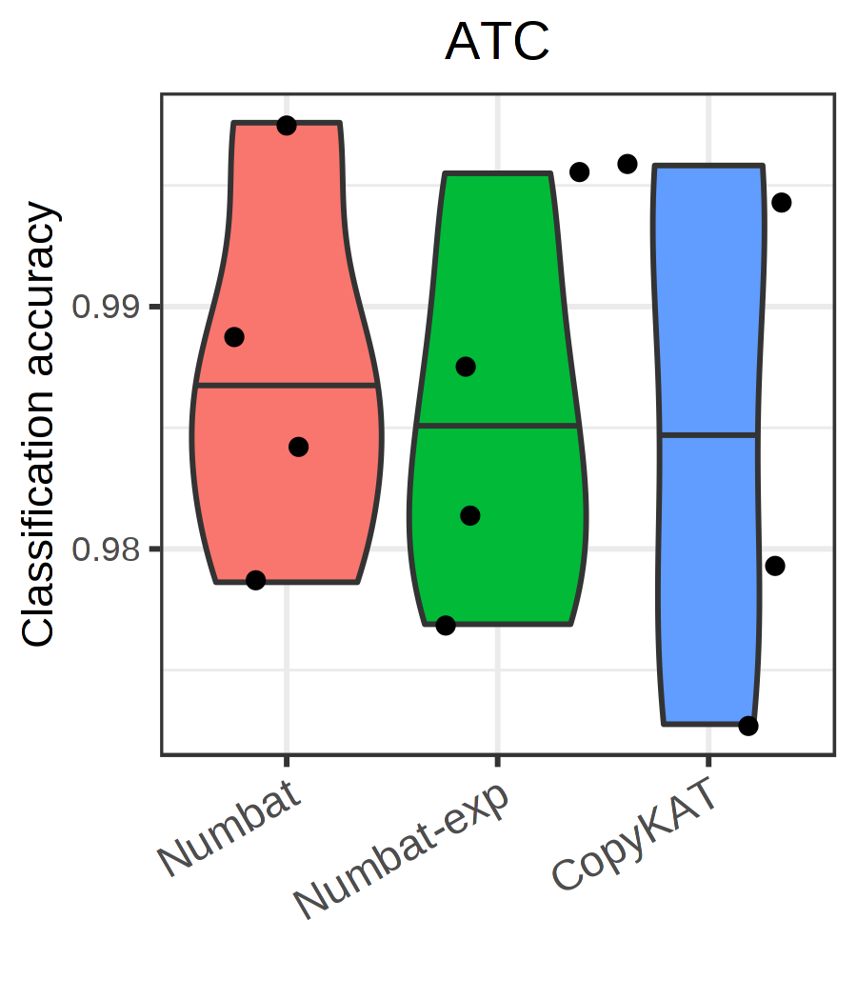

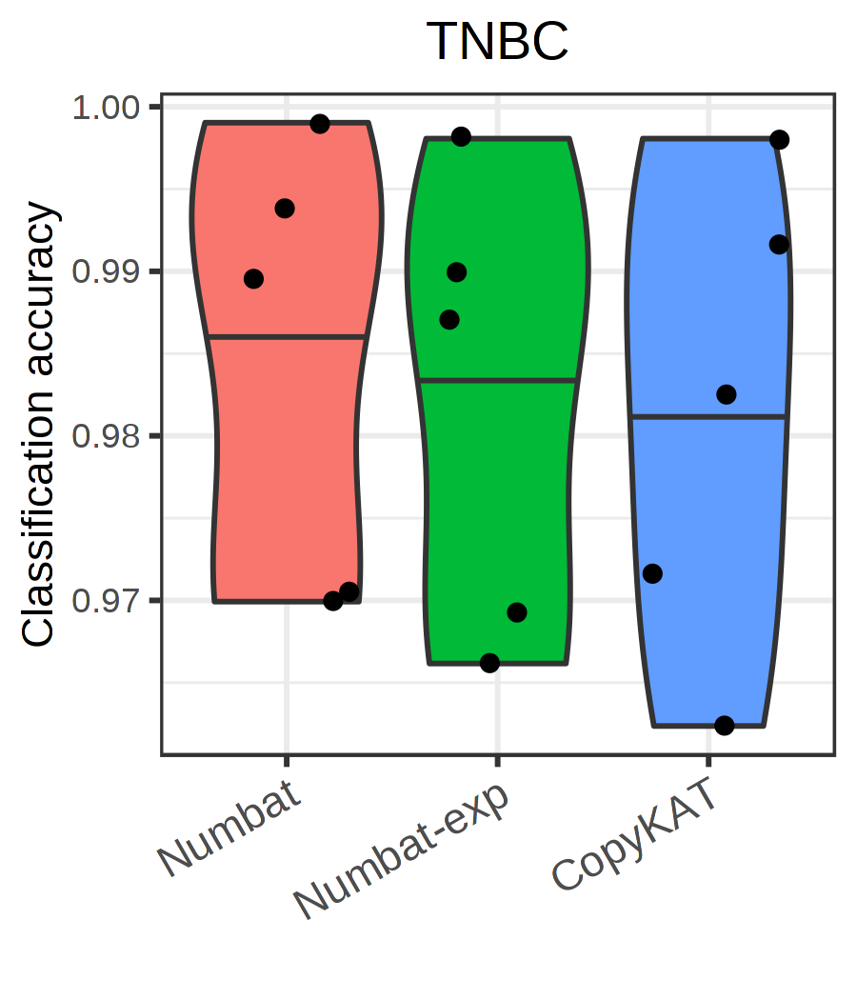

In [566]:
options(repr.plot.width = 3, repr.plot.height = 3.5, repr.plot.res = 300)

datasets = list('ATC' = paste0('ATC', 1:4), 'TNBC' = paste0('TNBC', 1:5))

for (series in names(datasets)) {
    
    clone_post = lapply(
        datasets[[series]], function(sample) {
            fread(glue('~/paper_data/numbat_out/{sample}/clone_post_2.tsv'))
        }
    ) %>%
    bind_rows()

    D = clone_post %>% 
        left_join(bind_rows(cell_annot), by = 'cell') %>%
        mutate(
            p_cnv = ifelse(is.na(p_cnv), 1 - p_1, p_cnv),
            numbat.pred = ifelse(p_cnv > 0.5, 'T', 'N'),
            numbat.exp.pred = ifelse(p_cnv_x > 0.5, 'T', 'N'),
            numbat.allele.pred = ifelse(p_cnv_y > 0.5, 'T', 'N')
        ) %>%
        select(copykat.pred, numbat.pred, numbat.exp.pred, numbat.allele.pred, cluster.pred, sample) %>%
        melt(measure.vars = c('numbat.pred', 'copykat.pred', 'numbat.exp.pred'),
             variable.name = 'method',
             value.name = 'pred') %>%
        mutate(method = c(
            'numbat.pred' = 'Numbat', 'numbat.exp.pred' = 'Numbat-exp', 
            'copykat.pred' = 'CopyKAT')[as.character(method)]
        ) %>%
        mutate(method = factor(method, c('Numbat', 'Numbat-exp', 'CopyKAT'))) %>%
        group_by(sample, method) %>%
        summarise(
            recall = mean(pred[cluster.pred == "T"] == "T"),
            precision = mean(cluster.pred[pred == "T"] == "T"),
            accuracy = mean(pred == cluster.pred),
            .groups = 'drop'
        )

    p = ggplot(
            D,
            aes(x = method, y = accuracy, fill = method)
        ) +
        geom_violin(draw_quantiles = c(0.5)) +
        geom_jitter() +
        theme_bw() +
        ylab('Classification accuracy') +
        xlab('') +
        ggtitle(series) +
        theme(
            plot.title = element_text(hjust = 0.5),
            legend.position = 'none',
            axis.text.x = element_text(size = 11, angle = 30, hjust = 1)
        )
    
    display(p)

    D %>%
    group_by(method) %>%
    summarise_at(
        c('recall', 'precision', 'accuracy'),
        function(x){signif(mean(x),3)}
    ) %>%
    display
}

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will rep

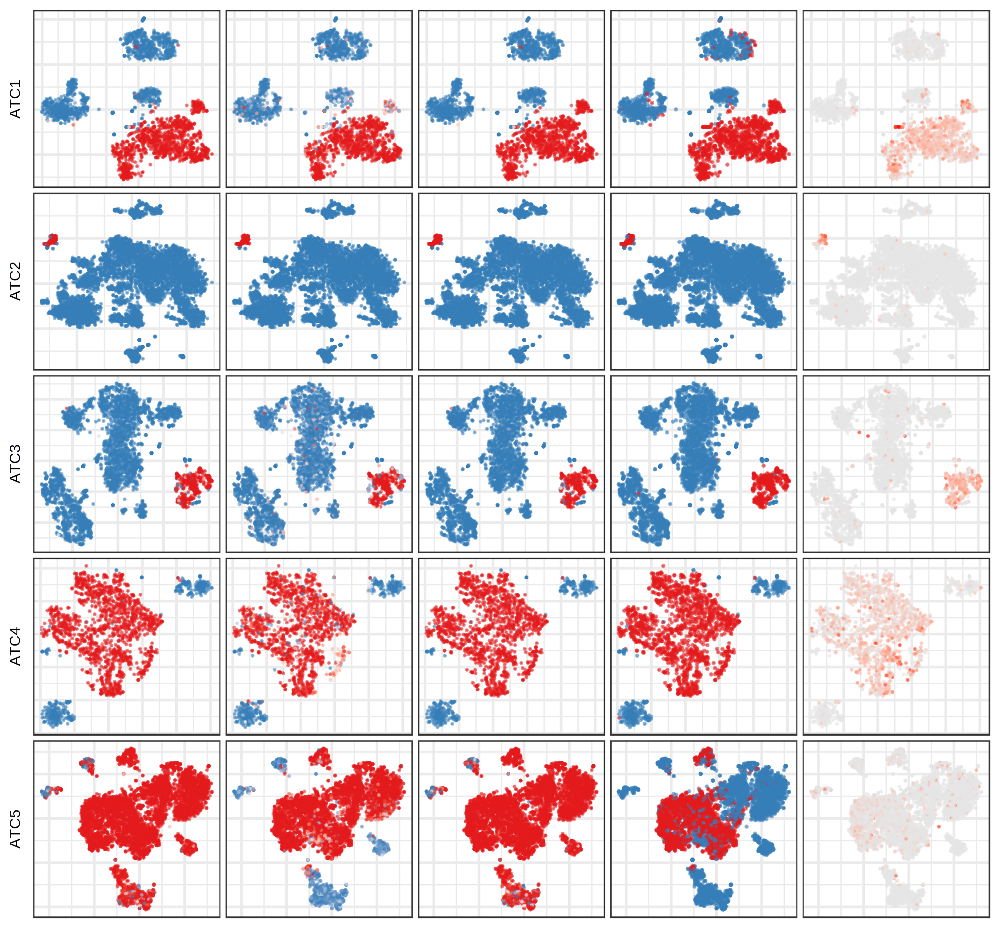

In [567]:
options(repr.plot.width = 7.5, repr.plot.height = 7, repr.plot.res = 300)

joint_plots = list()
copykat_plots = list()
exp_plots = list()
allele_plots = list()
marker_plots = list()
samples = c(paste0('ATC', 1:5))

for (sample in samples) {
    
    if (str_detect(sample, 'ATC')) {
        con = con_ATC
    } else {
        con = con_TNBC
    }

    marker = ifelse(str_detect(sample, 'ATC'), 'KRT8', 'EPCAM')
    
    clone_post = fread(glue('~/paper_data/numbat_out/{sample}/clone_post_2.tsv'))
    
    cell_clusters = con$samples[[sample]]$clusters$PCA$multilevel
    cell_clusters = cell_clusters[names(cell_clusters) %in% cell_annot[[sample]]$cell]

    marker_plots[[sample]] = con$samples[[sample]]$plotEmbedding(
        alpha=0.5,
        size=0.1, 
        plot.na = F,
        groups = cell_clusters,
        plot.theme = theme_bw(),
        gene = marker,
    ) +
    theme(
        plot.title = element_text(size = 8),
        plot.margin = margin(0,0,0,0)
    )
    
    exp_plots[[sample]] = con$samples[[sample]]$plotEmbedding(
        alpha=0.5,
        size=0.1, 
        colors = cell_annot[[sample]] %>% 
            left_join(clone_post, by = 'cell') %>%
            {setNames(.$p_cnv_x, .$cell)},
        show.legend = F,
        mark.groups = T,
        plot.na = F,
        plot.theme = theme_bw(),
    ) +
    theme(
        plot.title = element_text(size = 8),
        plot.margin = margin(0,0,0,0),
        axis.title.y = element_text(size = 8)
    ) +
    scale_color_gradient2(low = pal[2], high = pal[1], midpoint = 0.5, oob = scales::oob_squish) +
    ylab(sample)
    
    allele_plots[[sample]] = con$samples[[sample]]$plotEmbedding(
        alpha=0.5,
        size=0.1, 
        colors = cell_annot[[sample]] %>% 
            left_join(clone_post, by = 'cell') %>%
            {setNames(.$p_cnv_y, .$cell)},
        show.legend = F,
        mark.groups = T,
        plot.na = F,
        plot.theme = theme_bw(),
    #         title = sample,
    ) +
    theme(
        plot.title = element_text(size = 8),
        plot.margin = margin(0,0,0,0)
    ) +
    scale_color_gradient2(low = pal[2], high = pal[1], midpoint = 0.5, oob = scales::oob_squish)
    
    joint_plots[[sample]] = con$samples[[sample]]$plotEmbedding(
        alpha=0.5,
        size=0.1, 
        colors = cell_annot[[sample]] %>% 
            left_join(clone_post, by = 'cell') %>%
            {setNames(.$p_cnv, .$cell)},
        show.legend = F,
        mark.groups = T,
        plot.na = F,
        plot.theme = theme_bw(),
    ) +
    theme(
        plot.title = element_text(size = 8),
        plot.margin = margin(0,0,0,0)
    ) +
    scale_color_gradient2(low = pal[2], high = pal[1], midpoint = 0.5, oob = scales::oob_squish)
    
    
    copykat_plots[[sample]] = con$samples[[sample]]$plotEmbedding(
        alpha=0.5,
        size=0.2, 
        groups = cell_annot[[sample]] %>%
            {setNames(.$copykat.pred, .$cell)},
        show.legend = F,
        mark.groups = F,
        plot.na = F,
        plot.theme = theme_bw(),
        pal = c(pal[2], pal[1])
    ) +
    theme(
        plot.title = element_text(size = 8),
        plot.margin = margin(0,0,0,0)
    )
    
}

wrap_plots(c(rbind(exp_plots, allele_plots, joint_plots, copykat_plots, marker_plots)), ncol = 5, byrow = T)

## Phylogenies

In [6]:
res = list()

In [668]:
# R.utils::sourceDirectory('~/Numbat/R')
for (sample in paste0('TNBC', 2:5)) {
    res[[sample]] = fetch_results(glue('~/paper_data/numbat_out/{sample}'), i = 2)
}

In [ ]:
for (sample in samples) {
    tree_post = res[[sample]]$tree_post
    max_cost = 400

    G_m = get_mut_tree(tree_post$gtree, tree_post$mut_nodes)  %>% 
                simplify_history(tree_post$l_matrix, max_cost = max_cost) %>% 
                label_genotype()

    mut_nodes = G_m %>% igraph::as_data_frame('vertices') %>% 
        select(name = node, site = label, clone = clone, GT = GT)

    # update tree
    gtree = mut_to_tree(tree_post$gtree, mut_nodes)
    res[[sample]]$gtree = mark_tumor_lineage(gtree)
}

In [732]:
R.utils::sourceDirectory('~/Numbat/R')

plots = list()

for (sample in paste0('TNBC', 2:5)) {

    plots[[sample]] = plot_sc_joint(
        res[[sample]]$gtree,
        res[[sample]]$joint_post %>%
            mutate(cnv_state_map = cnv_state) %>%
            mutate(cnv_state = ifelse(cnv_state == 'bdel', 'del', cnv_state)),
        res[[sample]]$segs_consensus,
        tip_length = 1,
        branch_width = 0.3,
        size = 0.15,
        cell_dict = cell_annot[[sample]] %>% {setNames(.$cluster.pred, .$cell)},
        logBF_min = 2,
        logBF_max = 5,
        tree_height = 1.25,
        p_min = 0.9,
        clone_bar = F,
        clone_legend = F
    ) +
    ggtitle(sample)
    
}

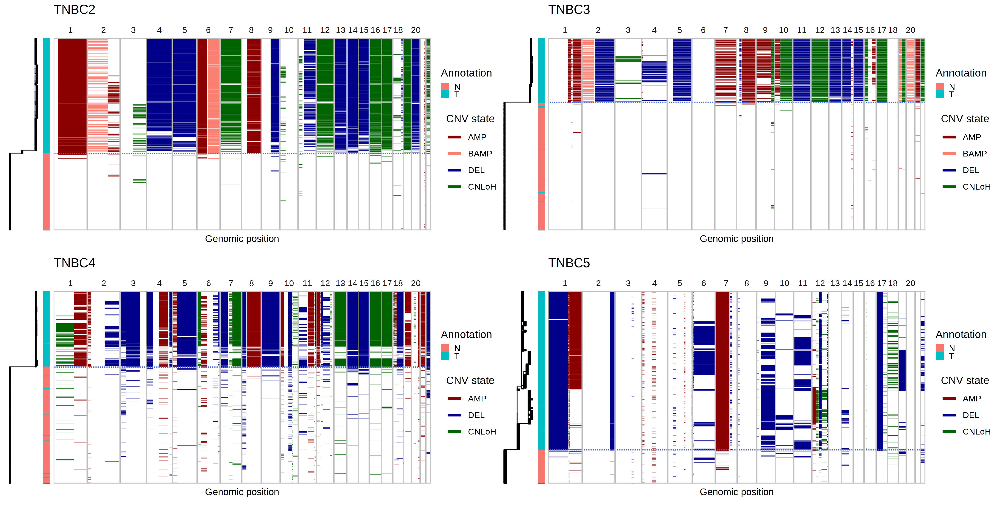

In [733]:
options(repr.plot.width = 14.5, repr.plot.height = 7.5, repr.plot.res = 300)

p = wrap_plots(plots, ncol = 2, guides = 'collect') &
    theme(plot.background = element_rect(fill = "transparent", color = NA))

p

ggsave("~/figures/tnbc_phylogenies.png", p, bg = "transparent", width = 14.5, height = 7.5, dpi = 300)

In [659]:
for (sample in paste0('ATC', 2:5)) {
    res[[sample]] = fetch_results(glue('~/paper_data/numbat_out/{sample}'), i = 2)
}

In [729]:
R.utils::sourceDirectory('~/Numbat/R')

plots = list()
samples = paste0('ATC', 2:5)

for (sample in samples) {
        
    plots[[sample]] = plot_sc_joint(
        res[[sample]]$gtree,
        res[[sample]]$joint_post,
        res[[sample]]$segs_consensus,
        tip_length = 0.5,
        branch_width = 0.3,
        size = 0.15,
        logBF_min = 2,
        logBF_max = 10,
        cell_dict = cell_annot[[sample]] %>% {setNames(.$cluster.pred, .$cell)},
        clone_bar = F,
        tree_height = 1.25,
        clone_legend = F,
        p_min = 0.9
    ) +
    ggtitle(sample)
}

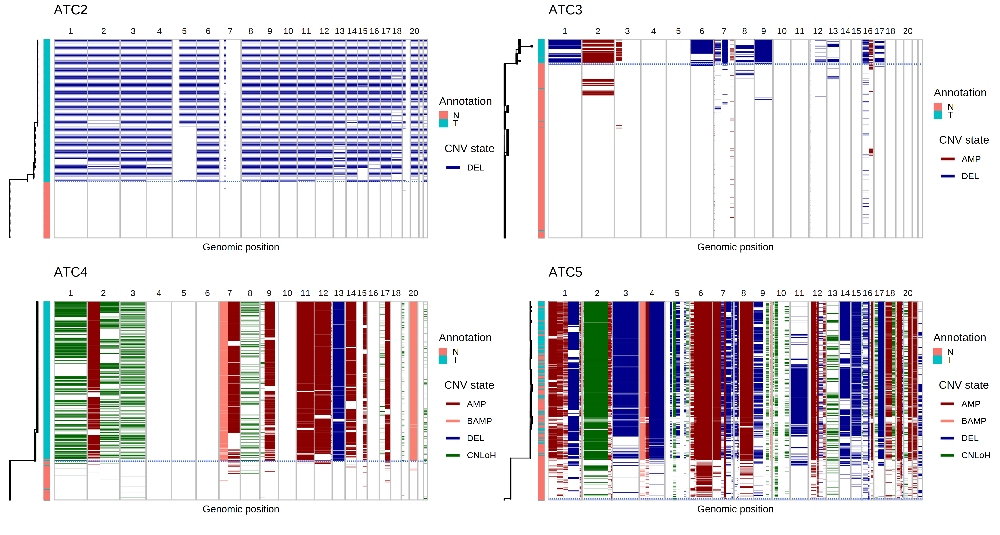

In [730]:
options(repr.plot.width = 14, repr.plot.height = 7.5, repr.plot.res = 300)

p = wrap_plots(plots, ncol = 2, guides = 'collect') &
    theme(plot.background = element_rect(fill = "transparent", color = NA))

p

ggsave("~/figures/atc_phylogenies.png", p, bg = "transparent", width = 14.5, height = 7.5, dpi = 300)

# mtRNA

In [1134]:
devtools::load_all('~/numbat')

ℹ Loading numbat

Warning message:
“replacing previous import ‘Matrix::expand’ by ‘ggtree::expand’ when loading ‘numbat’”


In [1315]:
mt_samples = c('TNBC1', 'TNBC2', 'TNBC5', 'ATC1', 'ATC2_subsampled')
samples = c(paste0('TNBC',1:5), 'ATC2_subsampled', 'ATC1', paste0('ATC', 3:5))

for (sample in 'ATC1') {
    message(sample)
    out_dir = glue('~/paper_data/numbat_out/{sample}')
    nb[[sample]] = Numbat$new(out_dir, i = 2, old_index = TRUE)
}

nb[['ATC2']] = nb[['ATC2_subsampled']] 

ATC1

Could not read the input file ~/paper_data/numbat_out/ATC1/gexp_roll_wide.tsv.gz with data.table::fread(). Please check that the file is valid.



In [637]:
VAF = list()

for (sample in c('TNBC1', 'TNBC2', 'TNBC5', 'ATC1', 'ATC2')) {
    AD = readMM(glue('~/mtRNA/mquad/{sample}/passed_ad.mtx')) %>% as.matrix
    DP = readMM(glue('~/mtRNA/mquad/{sample}/passed_dp.mtx')) %>% as.matrix
    cells = fread(glue('~/external/MDA/{sample}_barcodes.tsv'), header = F)$V1
    cells = paste0(sample, '_', cells)
    variants = fread(glue('~/mtRNA/mquad/{sample}/passed_variant_names.txt'), header = F)$V1
    VAF[[sample]] = AD/DP
    colnames(VAF[[sample]]) = cells
    rownames(VAF[[sample]]) = variants
    VAF[[sample]] = VAF[[sample]] %>% reshape2::melt() %>% setNames(c('variant', 'cell', 'VAF'))
}

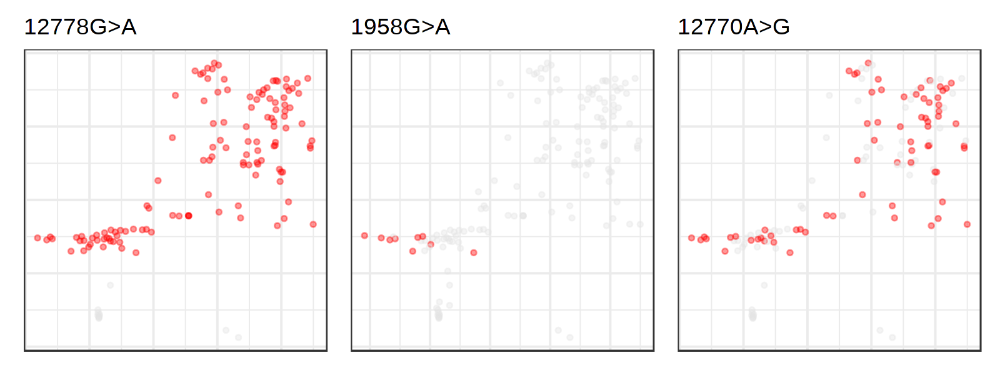

In [319]:
options(repr.plot.width = 8, repr.plot.height = 3, repr.plot.res = 200)

sample = 'ATC2'

cells = cell_annot[[sample]] %>% filter(cluster.pred == 'T') %>% pull(cell)

lapply(
    VAF[[sample]] %>% 
        filter(cell %in% cells) %>%
        group_by(variant) %>%
        filter(sum(VAF > 0.15, na.rm = T) > 3) %>%
        ungroup() %>%
        mutate(variant = factor(variant)) %>%
        split(.$variant),
    function(VAF) {
        con_ATC$samples[[sample]]$plotEmbedding(
            colors = VAF %>% {setNames(as.integer(.$VAF > 0.1), .$cell)},
            plot.na = F,
            size = 1,
            title = unique(VAF$variant)
        )
    }
) %>% 
wrap_plots()

Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


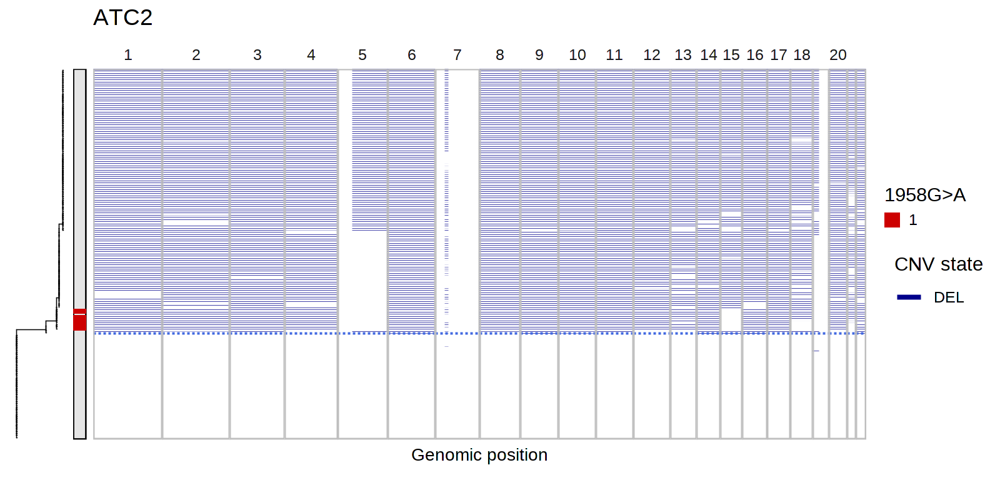

In [364]:
options(repr.plot.width = 8, repr.plot.height = 4, repr.plot.res = 200)

sample = 'ATC2'

var = '1958G>A'

plot_phylo_heatmap(
    nb[[sample]]$gtree, 
    nb[[sample]]$joint_post %>%
        left_join(
            nb[[sample]]$segs_consensus %>% select(seg = seg_cons, seg_start, seg_end),
            by = 'seg'
        ),
    nb[[sample]]$segs_consensus,
    annot = VAF[[sample]] %>% 
        filter(variant == var) %>%
        mutate(I = as.integer(VAF > 0.1)) %>%
        filter(I == 1) %>%
        {setNames(as.character(.$I), .$cell)},
    pal_annot = c('1' = 'red3'),
    geno_bar = F,
    annot_title = var
) +
ggtitle(sample)

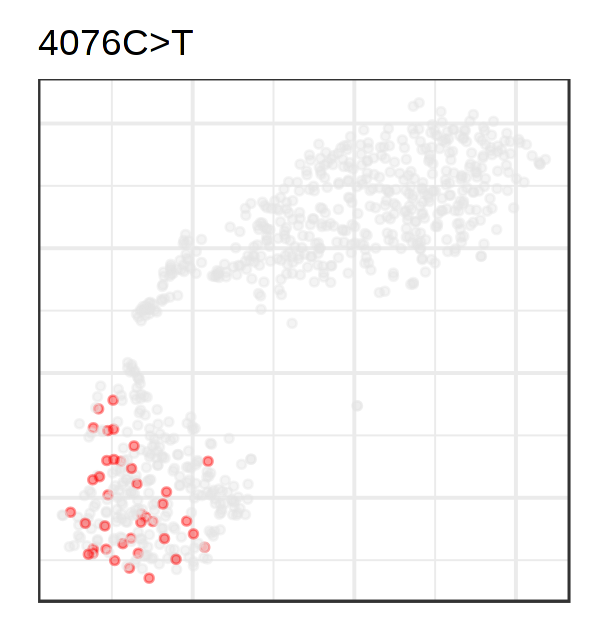

In [317]:
options(repr.plot.width = 3, repr.plot.height = 3.2, repr.plot.res = 200)

sample = 'TNBC1'

cells = cell_annot[[sample]] %>% filter(cluster.pred == 'T') %>% pull(cell)

lapply(
    VAF[[sample]] %>% 
        filter(cell %in% cells) %>%
        group_by(variant) %>%
        filter(sum(VAF > 0.15, na.rm = T) > 3) %>%
        ungroup() %>%
        mutate(variant = factor(variant)) %>%
        split(.$variant),
    function(VAF) {
        con_TNBC$samples[[sample]]$plotEmbedding(
            colors = VAF %>% {setNames(as.integer(.$VAF > 0.1), .$cell)},
            plot.na = F,
            size = 1,
            title = unique(VAF$variant)
        )
    }
) %>% 
wrap_plots()

In [784]:
sample = 'ATC1'

Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


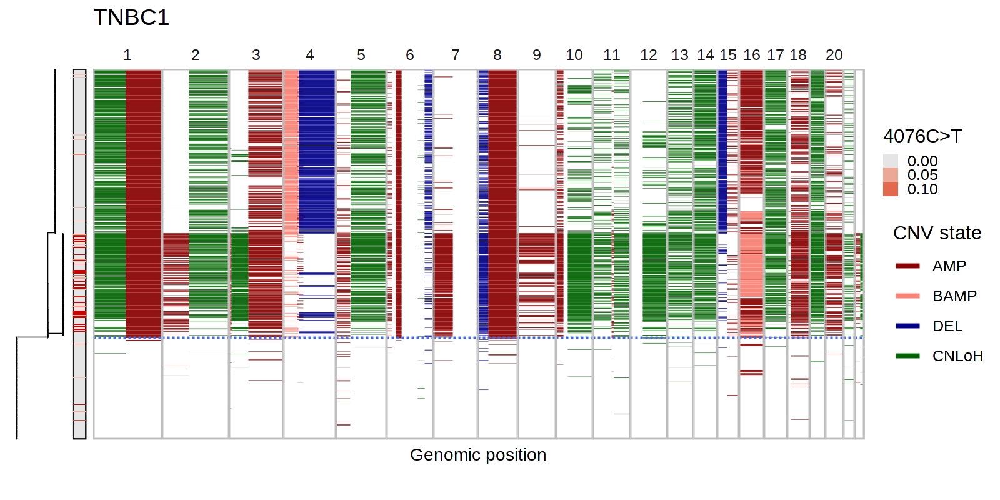

In [706]:
options(repr.plot.width = 8, repr.plot.height = 4, repr.plot.res = 200)

sample = 'TNBC1'

var = '4076C>T'

plot_phylo_heatmap(
    nb[[sample]]$gtree, 
    nb[[sample]]$joint_post %>%
        left_join(
            nb[[sample]]$segs_consensus %>% select(seg = seg_cons, seg_start, seg_end, n_states, cnv_states),
            by = 'seg'
        ),
    nb[[sample]]$segs_consensus,
    annot = VAF[[sample]] %>% 
        filter(variant == var) %>%
        mutate(I = as.integer(VAF > 0.1)) %>%
        filter(VAF > 0.02) %>%
        {setNames(.$VAF, .$cell)},
    pal_annot = c('1' = 'red3'),
    annot_title = var,
    annot_scale = scale_fill_gradient(low = 'gray90', high = 'red3', limits = c(0, 0.15), na.value = 'gray90', oob = scales::squish),
    geno_bar = F
) +
ggtitle(sample)

Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


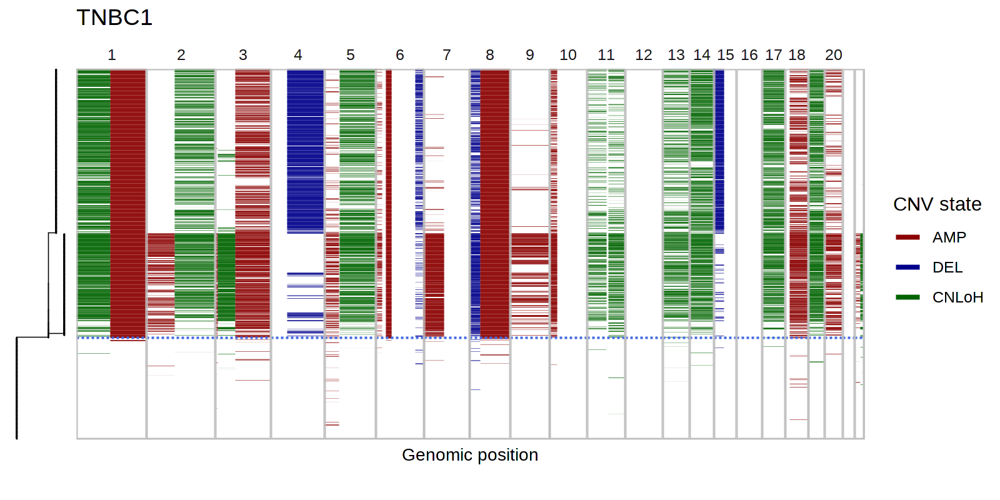

In [703]:
options(repr.plot.width = 8, repr.plot.height = 4, repr.plot.res = 200)

sample = 'TNBC1'

segs = mut_scores %>% filter(precision > 0.9) %>% pull(site) %>% str_remove('_del|_amp|_loh') %>% unique

plot_phylo_heatmap(
    nb[[sample]]$gtree, 
    nb[[sample]]$joint_post %>%
        left_join(
            nb[[sample]]$segs_consensus %>% select(seg = seg_cons, seg_start, seg_end),
            by = 'seg'
        ) %>%
        filter(seg %in% segs),
    nb[[sample]]$segs_consensus,
    pal_annot = c('1' = 'red3'),
    annot_title = var,
    geno_bar = F
) +
ggtitle(sample)

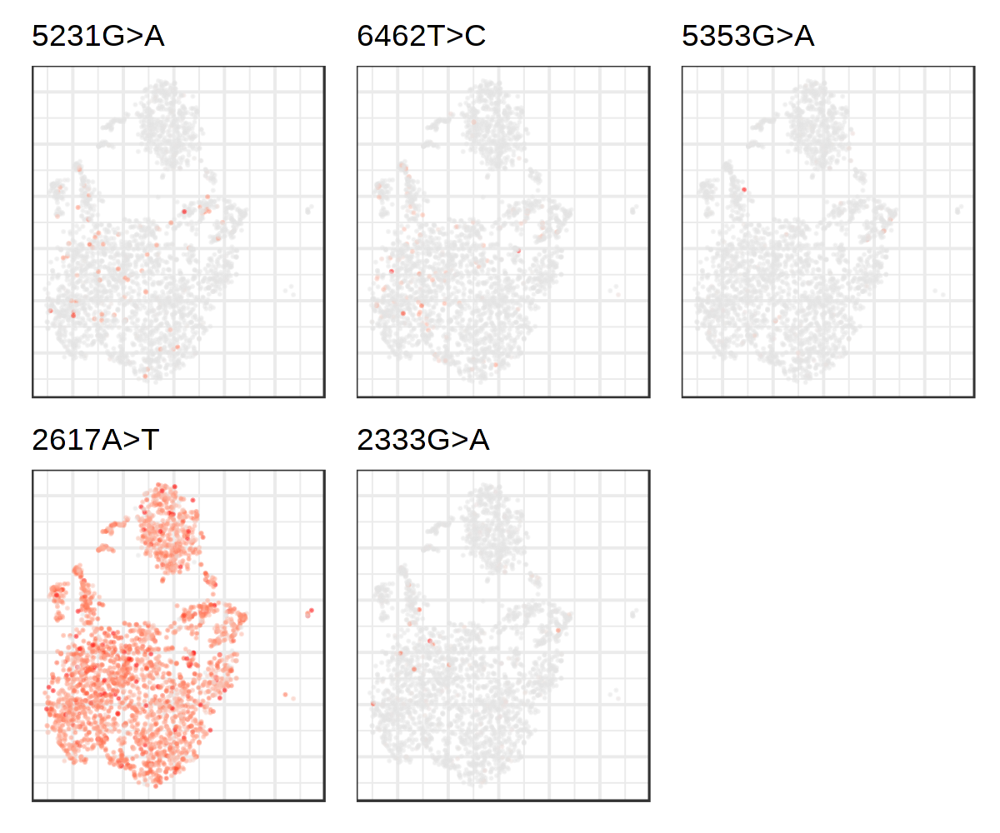

In [384]:
options(repr.plot.width = 6, repr.plot.height = 5, repr.plot.res = 200)

sample = 'TNBC5'
cells = cell_annot[[sample]] %>% filter(cluster.pred == 'T') %>% pull(cell)

lapply(
    VAF[[sample]] %>% 
        filter(cell %in% cells) %>%
        group_by(variant) %>%
        filter(sum(VAF > 0.15, na.rm = T) > 3) %>%
        ungroup() %>%
        mutate(variant = factor(variant)) %>%
        split(.$variant),
    function(VAF) {
        con_TNBC$samples[[sample]]$plotEmbedding(
            colors = VAF %>% {setNames(.$VAF, .$cell)},
            plot.na = F,
            size = 0.1,
            title = unique(VAF$variant)
        )
    }
) %>% 
wrap_plots()

In [635]:
devtools::load_all('~/Numbat')

ℹ Loading numbat

Warning message:
“replacing previous import ‘Matrix::expand’ by ‘ggtree::expand’ when loading ‘numbat’”


Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


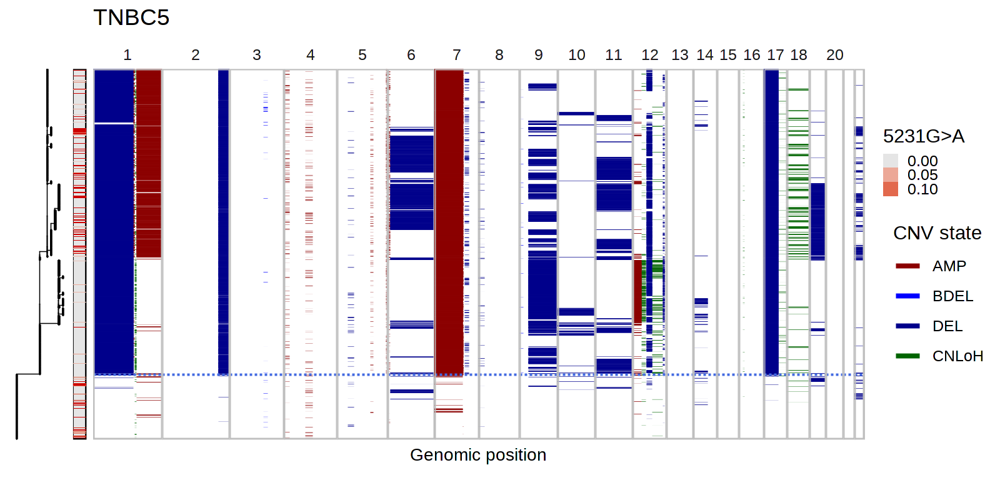

In [1352]:
options(repr.plot.width = 8, repr.plot.height = 4, repr.plot.res = 200)

sample = 'TNBC5'

var = '5231G>A'

plot_phylo_heatmap(
    nb[[sample]]$gtree, 
    nb[[sample]]$joint_post %>%
        left_join(
            nb[[sample]]$segs_consensus %>% select(seg = seg_cons, seg_start, seg_end),
            by = 'seg'
        ),
    nb[[sample]]$segs_consensus,
    annot = VAF[[sample]] %>% 
        filter(variant == var) %>%
        mutate(I = as.integer(VAF > 0.1)) %>%
        filter(VAF > 0.02) %>%
        {setNames(.$VAF, .$cell)},
    pal_annot = c('1' = 'red3'),
    annot_title = var,
    annot_scale = scale_fill_gradient(low = 'gray90', high = 'red3', limits = c(0, 0.15), na.value = 'gray90', oob = scales::squish),
    geno_bar = F
) +
ggtitle(sample)

Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


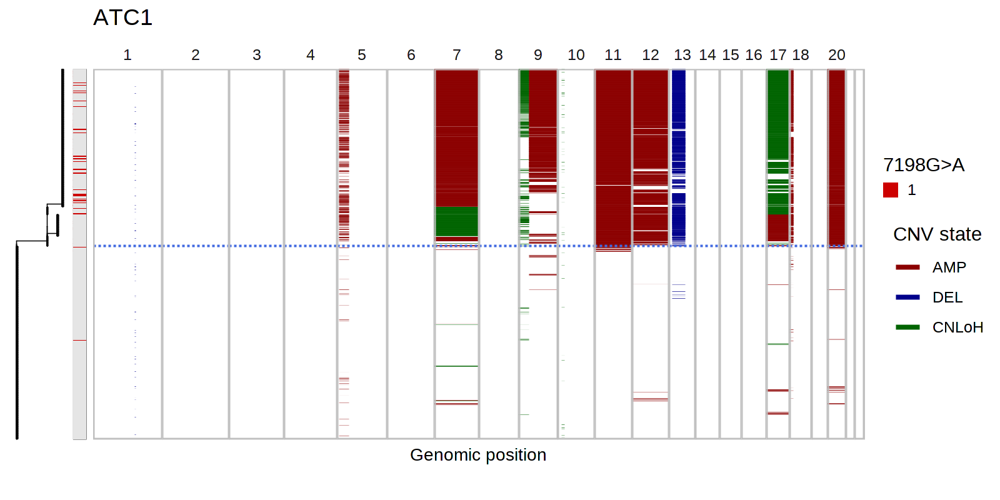

In [365]:
options(repr.plot.width = 8, repr.plot.height = 4, repr.plot.res = 200)

sample = 'ATC1'

var = '7198G>A'

plot_phylo_heatmap(
    nb[[sample]]$gtree, 
    nb[[sample]]$joint_post %>%
        left_join(
            nb[[sample]]$segs_consensus %>% select(seg = seg_cons, seg_start, seg_end, n_states, cnv_states),
            by = 'seg'
        ),
    nb[[sample]]$segs_consensus,
    annot = VAF[[sample]] %>% 
        filter(variant == var) %>%
        {setNames(as.factor(as.integer(.$VAF > 0.1)), .$cell)},
    pal_annot = c('1' = 'red3'),
    annot_title = var,
    geno_bar = F
) +
ggtitle(sample)

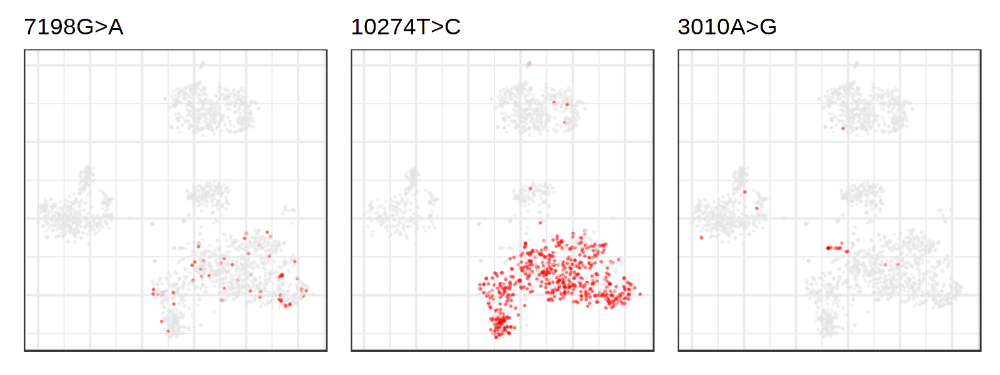

In [184]:
options(repr.plot.width = 8, repr.plot.height = 3, repr.plot.res = 200)

sample = 'ATC1'

lapply(
    VAF[[sample]] %>% 
        group_by(variant) %>%
        filter(sum(VAF > 0.1, na.rm = T) > 3) %>%
        ungroup() %>%
        mutate(variant = factor(variant)) %>%
        split(.$variant),
    function(VAF) {
        con_ATC$samples[[sample]]$plotEmbedding(
            colors = VAF %>% {setNames(as.integer(.$VAF > 0.15), .$cell)},
            plot.na = F,
            size = 0.1,
            title = unique(VAF$variant)
        )
    }
) %>% 
wrap_plots()

# Calling clones

In [1341]:
R.utils::sourceDirectory('~/Numbat/R')

for (sample in samples) {
    
    message(sample)
    
    nb[[sample]]$gtree = nb[[sample]]$gtree %>% annot_superclones(nb[[sample]]$geno, precision_cutoff = 0.9)

    superclone_dict = nb[[sample]]$gtree %>% as.data.frame() %>% count(GT, superclone) %>% {setNames(.$superclone, .$GT)}

    nb[[sample]]$mut_graph = nb[[sample]]$mut_graph %>%
        as_tbl_graph %>% 
        mutate(superclone = superclone_dict[GT]) %>%
        mutate(superclone = ifelse(is.na(superclone), 1, superclone)) %>%
        mutate(clone = superclone)
    
}

TNBC1

TNBC2

TNBC3

TNBC4

TNBC5

ATC2_subsampled

ATC1

ATC3

ATC4

ATC5



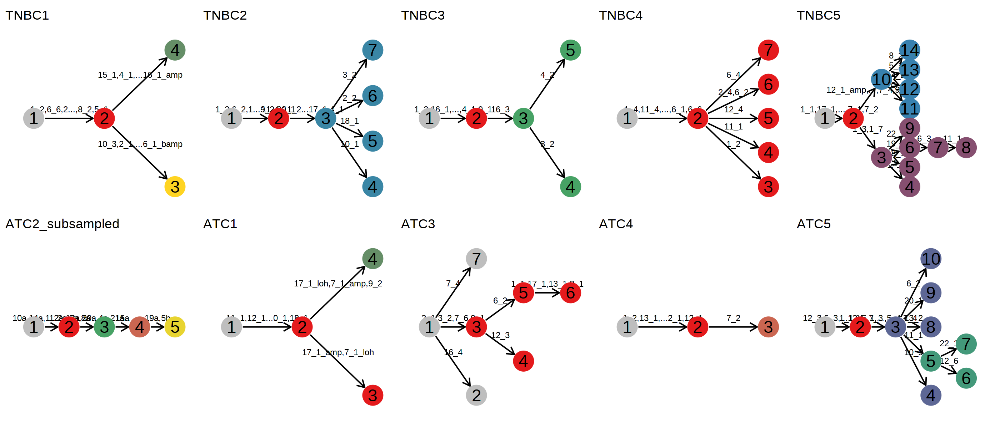

In [1354]:
options(repr.plot.width = 14, repr.plot.height = 6, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

lapply(
    samples,
    function(sample) {
        plot_mut_history(nb[[sample]]$mut_graph, edge_label_size = 3, node_size = 9) + ggtitle(sample)
}) %>% 
wrap_plots(nrow = 2)

# DCIS1

In [184]:
R.utils::sourceDirectory('~/Numbat/R')

sample = 'DCIS1'
out_dir = glue('~/paper_data/numbat_out/{sample}')
res[[sample]] = fetch_results(out_dir, i = 2)

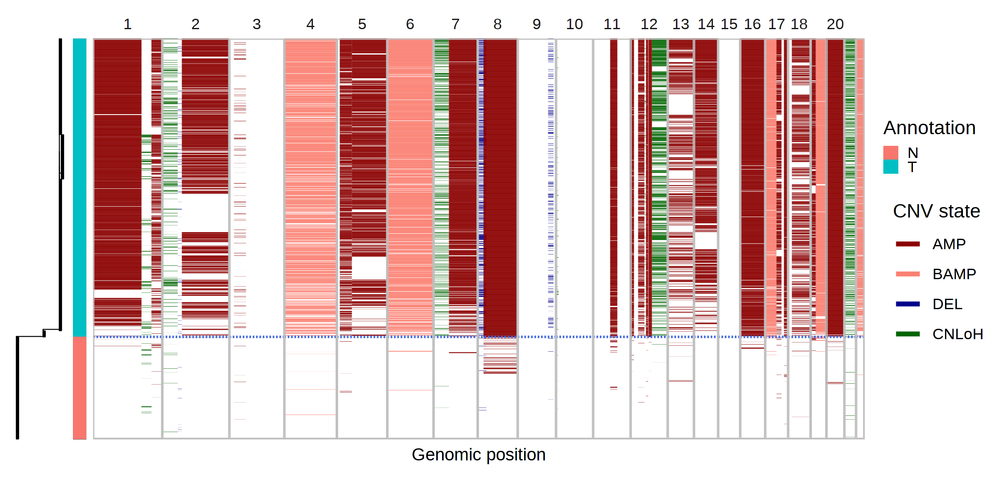

In [650]:
options(repr.plot.width = 8, repr.plot.height = 4, repr.plot.res = 300)
R.utils::sourceDirectory('~/Numbat/R')

sample = 'DCIS1'
plot_sc_joint(
    res[[sample]]$gtree,
    res[[sample]]$joint_post,
    res[[sample]]$segs_consensus,
    tip_length = 1,
    branch_width = 0.2,
    size = 0.075,
    p_min = 0.9,
    cell_dict = cell_annot[[sample]] %>% {setNames(.$cluster.pred, .$cell)}
)

In [591]:
copykat.cna = fread('~/paper_data/copykat_out/DCIS1/DCIS1_copykat_CNA_results.txt') %>%
    rename(CHROM = chrom, POS = chrompos)

In [621]:
sample = 'DCIS1'

copykat.pred = fread('~/paper_data/copykat_out/DCIS1/DCIS1_copykat_prediction.txt') %>% 
    rename(cell = cell.names, pred = copykat.pred)

copykat.cna.long = copykat.cna %>% 
    filter(CHROM != 23) %>%
    reshape2::melt(id.var = c('CHROM', 'POS'), variable.name = 'cell', value.name = 'score') %>%
    mutate(cell = str_replace(cell, '\\.', '-')) %>%
    left_join(copykat.pred, by = 'cell')

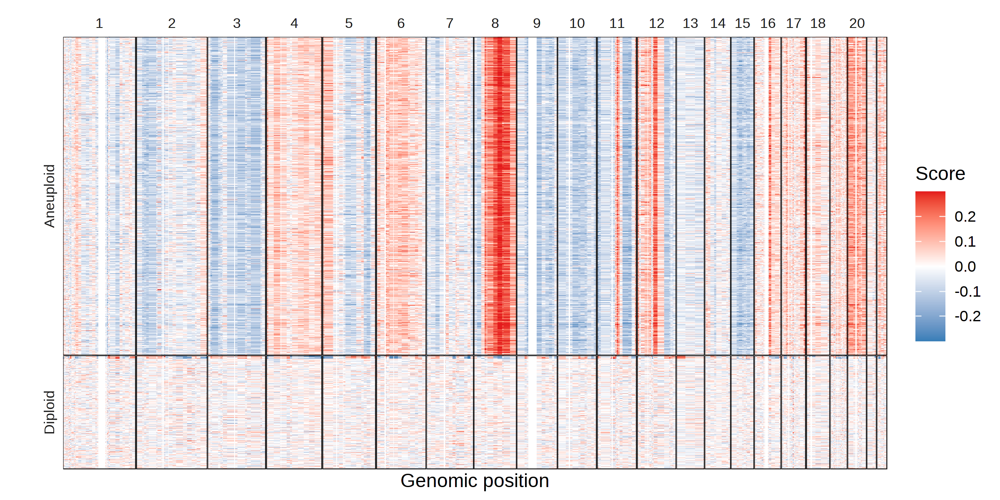

In [638]:
options(repr.plot.width = 8, repr.plot.height = 4, repr.plot.res = 300)

chrom_labeller <- function(chr){
        # chr[as.integer(chr) %% 2 == 0] = ''
        chr[chr %in% c(19, 21, 22)] = ''
        return(chr)
    }

copykat.cna.long %>%
filter(!is.na(pred)) %>%
# filter(cell %in% sample(unique(cell), 50)) %>%
mutate(pred = str_to_title(pred)) %>%
ggplot(
    aes(x = POS, y = cell, fill = score)
) +
xlab('Genomic position') +
ylab('') +
geom_tile() +
theme_classic() +
scale_y_discrete(expand = expansion(0)) +
scale_x_discrete(expand = expansion(add = 0.5)) +
theme(
    panel.spacing = unit(0.1, 'mm'),
    axis.line.x = element_blank(),
    axis.line.y = element_blank(),
    axis.ticks = element_blank(),
    panel.border = element_rect(color = 'black', size = 0.2, fill = NA),
    panel.background = element_rect(fill = 'white'),
    strip.background = element_blank(),
    axis.text = element_blank(),
    strip.text = element_text(angle = 0, size = 8)
) +
scale_fill_gradient2(low = pal[2], high = pal[1], midpoint = 0, limits = c(-0.3, 0.3), oob = scales::oob_squish, name = 'Score') +
facet_grid(pred~CHROM, scale = 'free', space = 'free', labeller = labeller(CHROM = chrom_labeller), switch = 'y')

### CNV Color legend

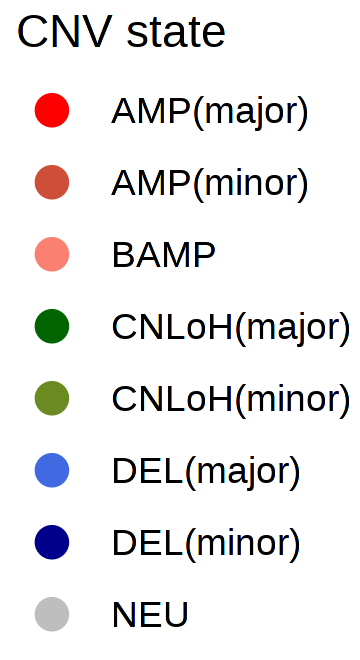

In [636]:
options(repr.plot.width = 1.2, repr.plot.height = 2.2, repr.plot.res = 300)

p = data.frame(
    state = c('AMP_up', 'AMP_down', 'DEL_up', 'DEL_down', 'CNLoH_up', 'CNLoH_down', 'NEU', 'BAMP')
) %>%
mutate(
    state = state %>% str_replace('_up', '(major)') %>% 
        str_replace('_down', '(minor)')
) %>%
ggplot(
    aes(x = state, y = state, color = state)
) +
geom_point() +
scale_color_manual(values = setNames(cnv_colors, names(cnv_colors) %>% 
    str_replace('_up', '(major)') %>% 
    str_replace('_down', '(minor)') %>%
    str_replace('loh', 'CNLoH') %>%
    str_replace('bamp', 'BAMP') %>%
    str_replace('amp', 'AMP') %>%
    str_replace('del', 'DEL') %>%
    str_replace('neu', 'NEU')
)) +
theme_classic() +
guides(color = guide_legend(override.aes = aes(size = 3), title = 'CNV state'))

get_legend(p) %>% as_ggplot

Warning message:
“Using alpha for a discrete variable is not advised.”


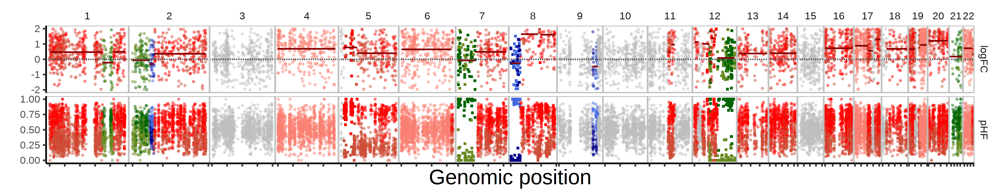

In [658]:
options(repr.plot.width = 12, repr.plot.height = 2.35, repr.plot.res = 300)
R.utils::sourceDirectory('~/Numbat/R')
sample = 'DCIS1'
res[[sample]]$bulk_subtrees %>% 
filter(sample %in% c(4)) %>% 
plot_psbulk(phi_mle = T, legend = F, use_pos = TRUE) +
theme(axis.title.x = element_text(size = 18))

# TNBC2

In [714]:
# R.utils::sourceDirectory('~/Numbat/R')

sample = 'TNBC2'
# out_dir = glue('~/paper_data/numbat_out/{sample}')
# res[[sample]] = fetch_results(out_dir, i = 2)

In [813]:
clones = gtree %>%
        activate(nodes) %>%
        data.frame() %>% 
        # mutate(GT = ifelse(compartment == 'normal', '', GT)) %>%
        group_by(GT, clone, compartment) %>%
        summarise(
            clone_size = sum(leaf),
            .groups = 'drop'
        )

In [834]:
clones = gtree %>%
    activate(nodes) %>%
    data.frame() %>% 
    # mutate(GT = ifelse(compartment == 'normal', '', GT)) %>%
    group_by(GT, clone, compartment) %>%
    summarise(
        clone_size = sum(leaf),
        .groups = 'drop'
    )

In [931]:
devtools::load_all('~/Numbat')

ℹ Loading numbat

Warning message:
“replacing previous import ‘Matrix::expand’ by ‘ggtree::expand’ when loading ‘numbat’”


In [ ]:
gtree = annot_superclones(nb[[sample]]$gtree, nb[[sample]]$geno)

Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


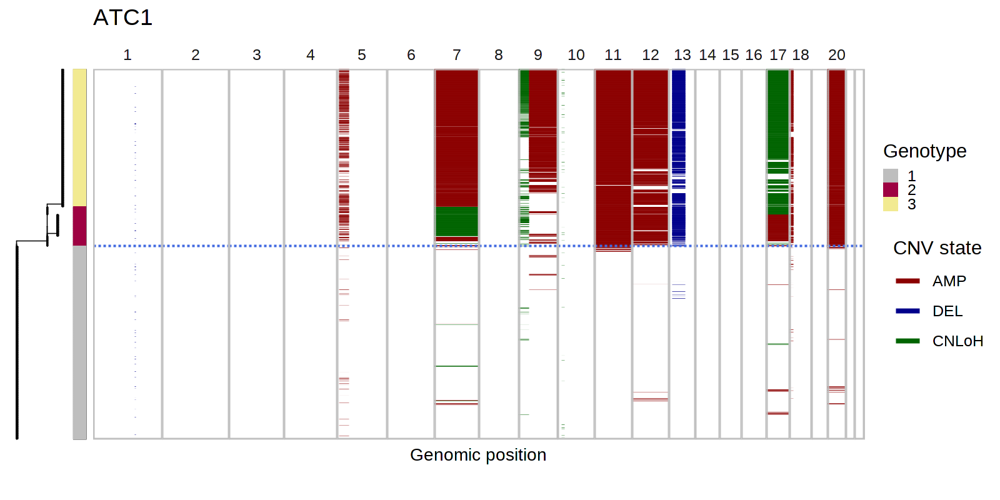

In [944]:
options(repr.plot.width = 8, repr.plot.height = 4, repr.plot.res = 200)

sample = 'ATC1'

gtree = annot_superclones(nb[[sample]]$gtree, nb[[sample]]$geno)

plot_phylo_heatmap(
    gtree, 
    nb[[sample]]$joint_post %>%
        left_join(
            nb[[sample]]$segs_consensus %>% 
                select(any_of(c('seg' = 'seg_cons', 'seg_start', 'seg_end', 'n_states', 'cnv_states'))),
            by = 'seg'
        ),
    nb[[sample]]$segs_consensus,
    pal_annot = c('1' = 'red3'),
    annot_title = var,
    geno_bar = T,
    superclone = T
) +
ggtitle(sample)

Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


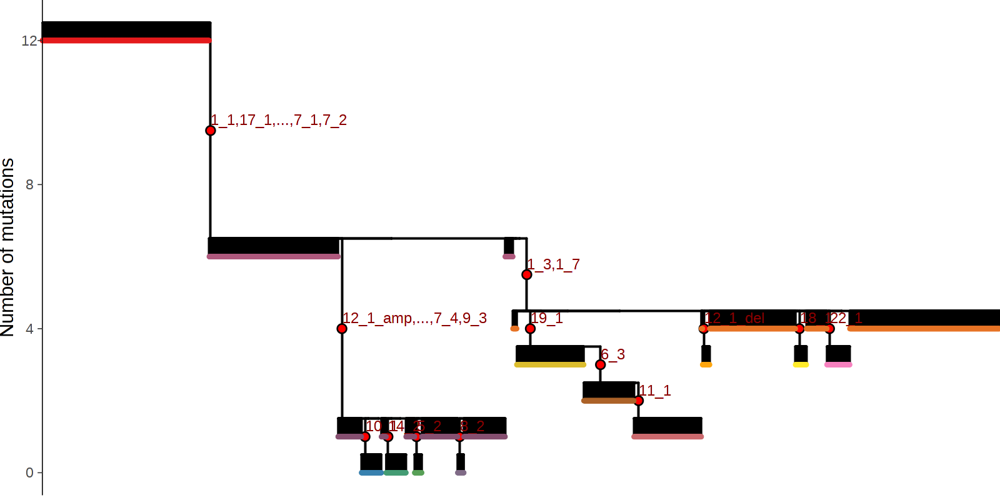

In [839]:
nb[[sample]]$gtree %>%
    activate(nodes) %>%
    mutate(clone = as.integer(factor(GT))) %>%
    plot_sc_tree()

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.



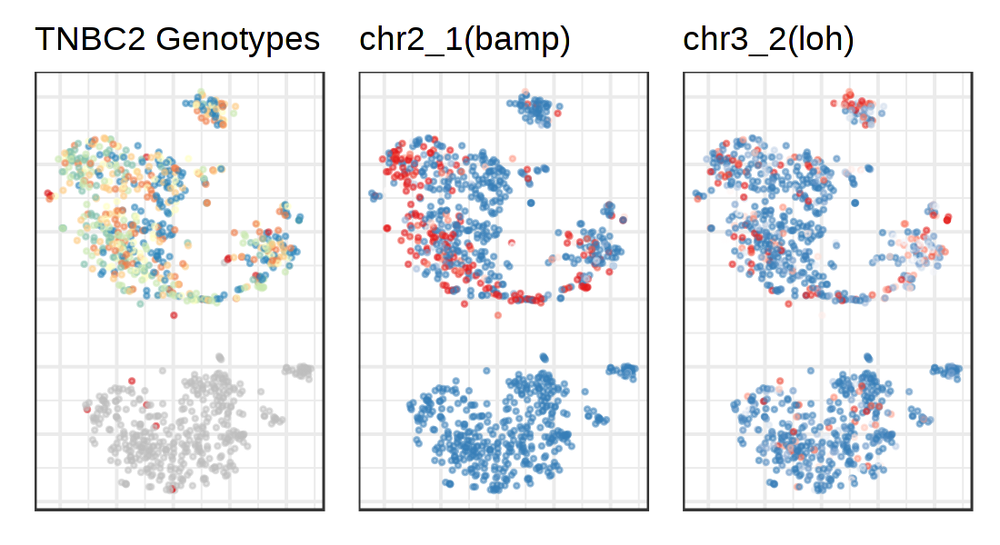

In [443]:
options(repr.plot.width = 5.5, repr.plot.height = 3, repr.plot.res = 200)
sample = 'TNBC2'
muts = c('2_1', '3_2')
cnv_states = res[[sample]]$joint_post %>% distinct(seg, cnv_state) %>% {setNames(.$cnv_state, .$seg)}
getPalette = colorRampPalette(RColorBrewer::brewer.pal(n = 5, 'Spectral'))

p_clones = con_TNBC$samples[[sample]]$plotEmbedding(
    alpha=0.5,
    size=0.5, 
    groups = res[[sample]]$clone_post %>%
        {setNames(.$clone_opt, .$cell)},
    show.legend = F,
    mark.groups = F,
    plot.na = F,
    plot.theme = theme_bw(),
    title = paste0(sample, ' Genotypes'),
    pal = c('gray', getPalette(length(unique(res[[sample]]$clone_post$clone_opt))-1))
)
# scale_color_manual(values = c('Normal' = 'gray', 'A' = pal[3], 'B' = pal[4]))

plist = list()
plist[[1]] = p_clones

for (mut in muts) {
    
    plist[[mut]] = con_TNBC$samples[[sample]]$plotEmbedding(
        alpha=0.5,
        size=0.5, 
        plot.na = F, 
        colors = res[[sample]]$joint_post %>%
            left_join(
                res[[sample]]$clone_post %>% select(clone_opt, cell), by = 'cell'
            ) %>%
            filter(seg == mut) %>%
            {setNames(.$p_cnv, .$cell)},
        show.legend = F,
        mark.groups = F,
        plot.theme = theme_bw(),
        title = paste0('chr', mut, '(', cnv_states[mut], ')')
#         title = mut
    ) +
    scale_color_gradient2(
        low = pal[2], mid = 'white', high = pal[1],
        midpoint = 0.5, guide = guide_colorbar(title = 'Posterior\nprobability'), limits = c(0,1)
    )
}

wrap_plots(plist, nrow = 1, legend = 'top')

# TNBC1

In [74]:
nb = list()

In [1560]:
R.utils::sourceDirectory('~/Numbat/R')

sample = 'ATC1'
out_dir = glue('~/paper_data/numbat_out/{sample}_iter')
nb[[sample]] = Numbat$new(out_dir, i = 1)

In [1562]:
nb[[sample]]$bulk_clones %>% filter(CHROM == 17) %>% distinct(sample, seg, LLR, cnv_state, p_bamp, p_amp, p_loh)

sample,seg,cnv_state,p_loh,p_amp,p_bamp,LLR
<int>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>
1,17a,loh_2,0.5092812964,5.082523e-13,1.010256e-04,17.07718
2,17a,loh_2,0.9999999923,6.787447e-271,0.000000e+00,5288.57919
3,17a,loh_2,0.0003982579,9.996017e-01,1.155621e-146,592.56823


In [545]:
tree_post = res[[sample]]$tree_post
max_cost = 400

G_m = get_mut_tree(tree_post$gtree, tree_post$mut_nodes)  %>% 
            simplify_history(tree_post$l_matrix, max_cost = max_cost) %>% 
            label_genotype()

mut_nodes = G_m %>% igraph::as_data_frame('vertices') %>% 
    select(name = node, site = label, clone = clone, GT = GT)

# update tree
gtree = mut_to_tree(tree_post$gtree, mut_nodes)
res[[sample]]$gtree = mark_tumor_lineage(gtree)

In [143]:
chrs = c(1,2,3)

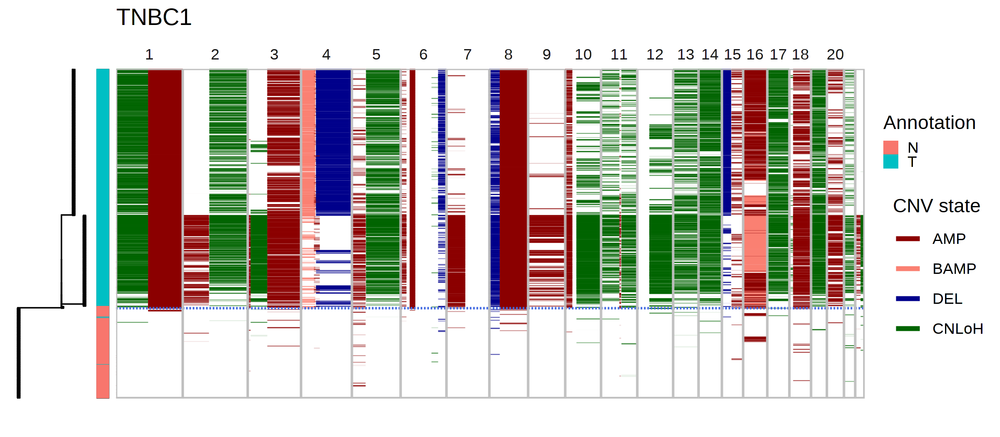

In [726]:
options(repr.plot.width = 8, repr.plot.height = 3.5, repr.plot.res = 300)
R.utils::sourceDirectory('~/Numbat/R')

sample = 'TNBC1'

getPalette = colorRampPalette(pal)

p = plot_sc_joint(
        res[[sample]]$gtree,
        res[[sample]]$joint_post,
        res[[sample]]$segs_consensus,
        tip_length = 1,
        branch_width = 0.3,
        size = 0.15,
        logBF_min = 2,
        logBF_max = 5,
        cell_dict = cell_annot[[sample]] %>% {setNames(.$cluster.pred, .$cell)},
        pal_clone = c('gray', 'red3', pal[3], pal[4]),
        clone_bar = F,
        p_min = 0.9,
        tree_height = 1.5,
        multi_allelic = TRUE
    ) +
    theme(axis.title.x = element_blank()) +
    ggtitle(sample) & 
    theme(plot.background = element_rect(fill = "transparent", color = NA)) 

ggsave("~/figures/TNBC1_phylogeny.png", p, bg = "transparent", width = 8, height = 3.5, dpi = 300)

p

In [ ]:
R.utils::sourceDirectory('~/Numbat/R')

bulk = res[[sample]]$bulk_clones %>% filter(sample == 4) %>% analyze_bulk(t = 1e-1, diploid_chroms = c(13,14,19))

Retesting CNVs..



In [ ]:
options(repr.plot.width = 14, repr.plot.height = 2, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')
sample = 'TNBC1'

bulk %>% plot_bulks(phi_mle = TRUE, legend = F)

In [261]:
R.utils::sourceDirectory('~/Numbat/R')

bulks = res[[sample]]$bulk_subtree %>% run_group_hmms(t = 1e-5, diploid_chroms = c(13,14,19))

Warning message:
“Removed 80362 rows containing missing values (geom_point).”
Warning message:
“Removed 82572 rows containing missing values (geom_point).”


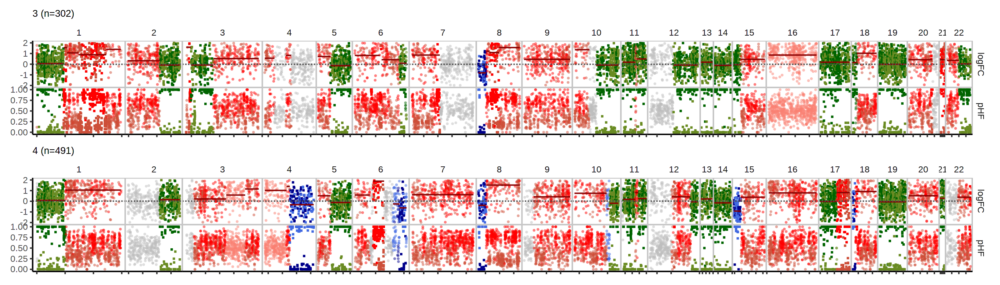

In [280]:
options(repr.plot.width = 14, repr.plot.height = 4, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')
sample = 'TNBC1'

res[[sample]]$bulk_clones %>% 
    filter(sample %in% c(3,4)) %>% 
    plot_bulks(phi_mle = TRUE, legend = F)

In [659]:
fread('~/ref/chromosome.band.hg38.txt') %>% filter(`#chrom` == 'chr15') %>% filter(gieStain == 'acen')

#chrom,chromStart,chromEnd,name,gieStain
<chr>,<int>,<int>,<chr>,<chr>
chr15,17500000,19000000,p11.1,acen
chr15,19000000,20500000,q11.1,acen


In [655]:
res[[sample]]$segs_consensus %>% 
filter(CHROM == 15)

sample,CHROM,seg,cnv_state,cnv_state_post,seg_start,seg_end,seg_start_index,seg_end_index,theta_mle,theta_sigma,phi_mle,phi_sigma,p_loh,p_del,p_amp,p_bamp,p_bdel,LLR,LLR_y,LLR_x,n_genes,n_snps,component,LLR_sample,seg_length,seg_cons,cnv_states,n_states
<int>,<int>,<chr>,<chr>,<chr>,<int>,<int>,<int>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<int>,<int>,<dbl>,<int>,<chr>,<list>,<int>
2,15,15_1,loh_2,del,22786225,57591904,44299,44782,0.3919180,0.008315930,0.7297503,0.05187467,0.01022243,9.897776e-01,4.653027e-18,0.00000e+00,0.000000e+00,461.1024,451.2808,9.821648,124,375,20,461.1024,34805679,15_1,del,1
4,15,15_2,amp_1,amp,58817580,101659107,44790,46455,0.1692637,0.006609483,1.2944761,0.07764545,0.03139212,5.188994e-09,9.686079e-01,2.24418e-56,1.202245e-64,244.8849,235.6271,9.257848,174,1396,21,244.8849,42841527,15_2,amp,1


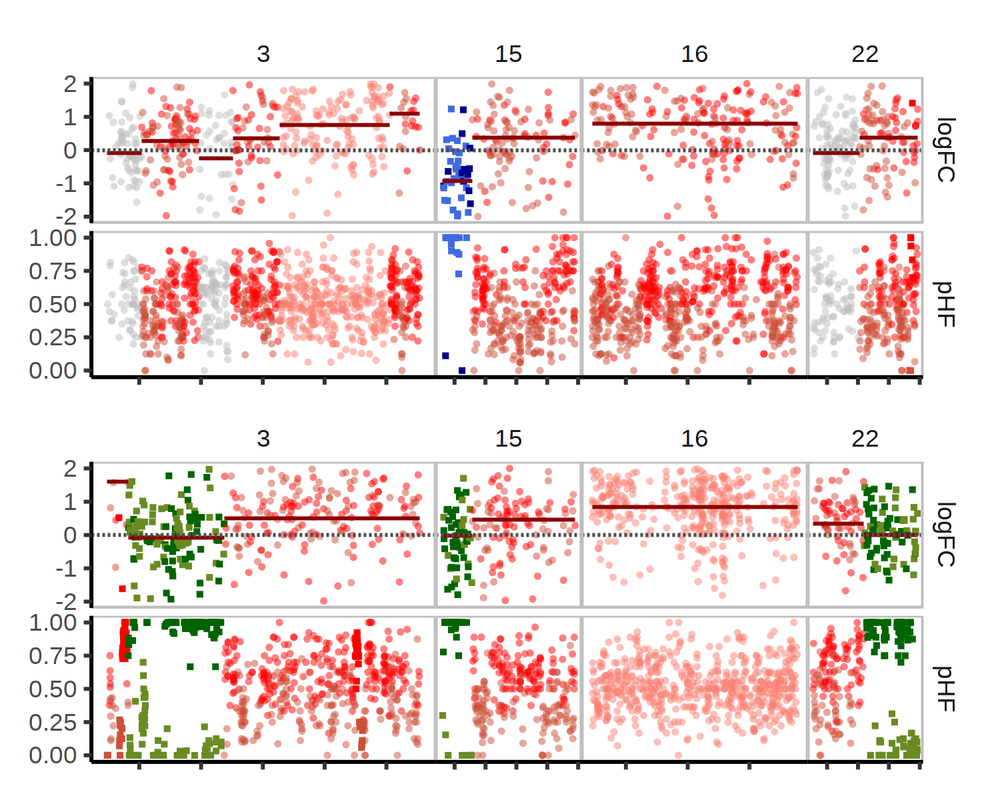

In [434]:
options(repr.plot.width = 5, repr.plot.height = 4, repr.plot.res = 300)
R.utils::sourceDirectory('~/Numbat/R')
sample = 'TNBC1'

res[[sample]]$bulk_subtrees %>% 
    filter(sample %in% c(3,4)) %>% 
    mutate(sample = factor(sample, c(4,3))) %>%
    mutate(state_post = ifelse(state_post == 'amp', 'bamp', state_post)) %>%
    filter(CHROM %in% c(3, 15, 16, 22)) %>%
    plot_bulks(phi_mle = TRUE, legend = F, use_pos = F, title = F) %>%
    do_plot('TNBC1_segs', 5, 4)

Scale for 'y' is already present. Adding another scale for 'y', which will
replace the existing scale.



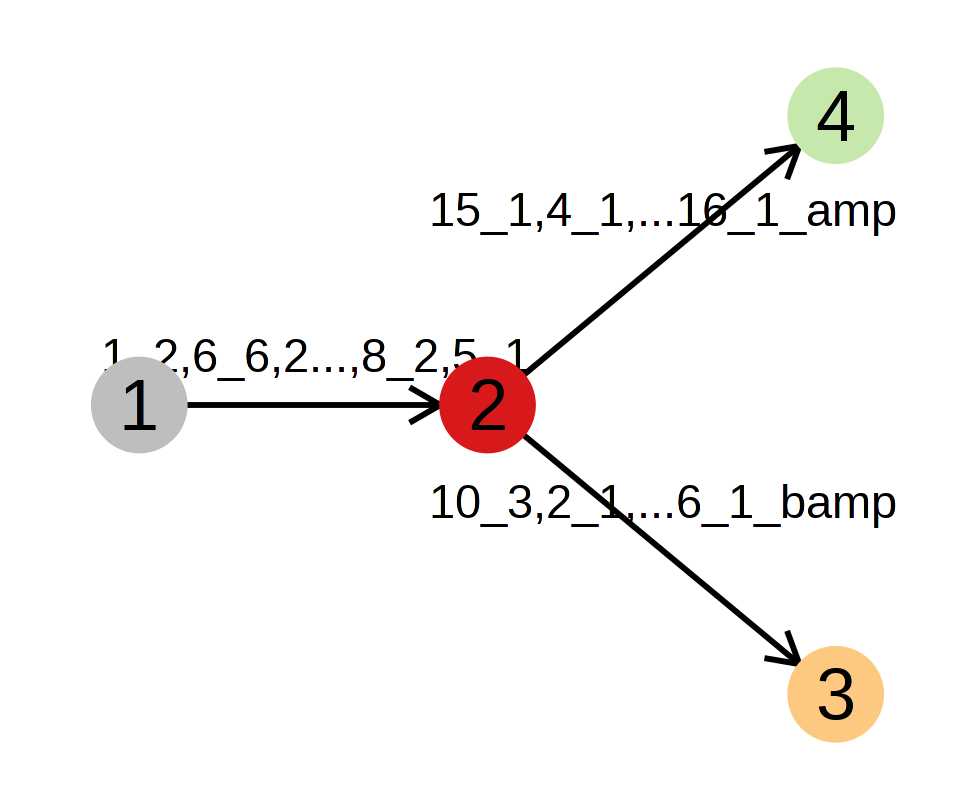

In [441]:
res[[sample]]$G_m %>% plot_mut_history()

In [440]:
res[[sample]]$clone_post %>% distinct(clone_opt, GT_opt)

clone_opt,GT_opt
<int>,<chr>
4,"1_2,6_6,2_2,8_1,11_2,13_1,14_1,17_1,19_1,20_1,5_2,6_1,1_3,10_1,11_4,3_5,18_2,6_3,8_2,5_1,15_1,4_1,4_3,15_2,16_1_amp"
1,
3,"1_2,6_6,2_2,8_1,11_2,13_1,14_1,17_1,19_1,20_1,5_2,6_1,1_3,10_1,11_4,3_5,18_2,6_3,8_2,5_1,10_3,2_1,12_2,22_3,3_1,3_3,7_1,22_1,9_1,16_1_bamp"
2,"1_2,6_6,2_2,8_1,11_2,13_1,14_1,17_1,19_1,20_1,5_2,6_1,1_3,10_1,11_4,3_5,18_2,6_3,8_2,5_1"


Joining, by = "cell"

Warning message:
“Removed 5 rows containing missing values (geom_point).”


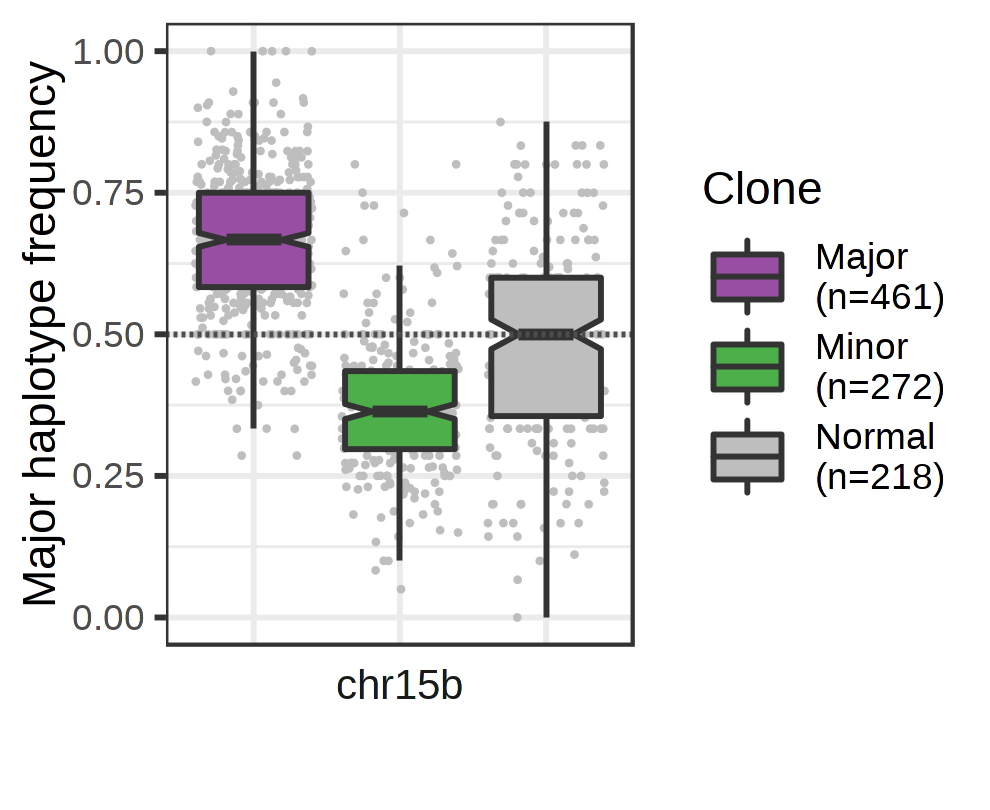

In [37]:
options(repr.plot.width = 3.3, repr.plot.height = 2.7, repr.plot.res = 300)
R.utils::sourceDirectory('~/Numbat/R')

sample = 'TNBC1'
# segs = c('9_2', '15_2')
segs = c('15_2')
clone_dict = c('4' = 'Major', '3' = 'Minor', '1' = 'Normal')

res[[sample]]$allele_post %>% 
filter(seg %in% segs) %>%
mutate(seg = factor(seg, segs)) %>%
arrange(seg) %>%
rowwise() %>%
mutate(seg = paste0('chr', sapply(seg, function(seg) {rename_seg(seg)}))) %>%
ungroup() %>%
mutate(seg = factor(seg, unique(seg))) %>%
left_join(
    res[[sample]]$clone_post %>%
#         mutate(clone_opt = ifelse(clone_opt %in% c(3,4), 3, clone_opt)) %>%
        select(clone = clone_opt, cell = cell)
) %>%
mutate(clone = clone_dict[as.character(clone)]) %>%
filter(!is.na(clone)) %>%
filter(total >= 5) %>%
group_by(clone) %>%
mutate(n_clone = n()) %>%
mutate(clone = glue('{clone}\n(n={n_clone})')) %>%
ungroup() %>%
ggplot(
    aes(x = clone, y = MAF, fill = clone)
) +
theme_bw() +
geom_jitter(size = 0.1, color = 'gray') +
geom_boxplot(alpha = 1, notch = T, outlier.alpha = 0) +
geom_hline(yintercept = 0.5, linetype = 'dashed', color = 'gray30') +
# geom_hline(yintercept = 0.66, linetype = 'dashed', color = 'royalblue') +
# geom_hline(yintercept = 0.33, linetype = 'dashed', color = 'royalblue') +
# ggtitle('chr9') +
facet_wrap(~seg, strip.position = 'bottom') +
theme(
#     strip.background = element_rect(size = 0, fill = NULL)
    strip.background = element_blank(),
    panel.spacing = unit(0.5, 'cm'),
    strip.text = element_text(size = 10),
    axis.ticks.x = element_blank(),
    axis.text.x = element_blank(),
    plot.caption = element_text(hjust = 0)
) +
scale_fill_manual(
    values = c(pal[4], pal[3], 'gray'),
    name = 'Clone'
) +
guides(fill=guide_legend(
         keywidth=0.3,
         keyheight=0.3,
         default.unit="inch")
) +
ylim(0,1) +
ylab('Major haplotype frequency') +
xlab('')

In [140]:
R.utils::sourceDirectory('~/Numbat/R')

sample = 'TNBC1'
out_dir = glue('~/paper_data/numbat_out/{sample}')
res[[sample]] = fetch_results(out_dir, i = 2)

In [512]:
segs_consensus = get_segs_consensus(bulk_subtrees)

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.



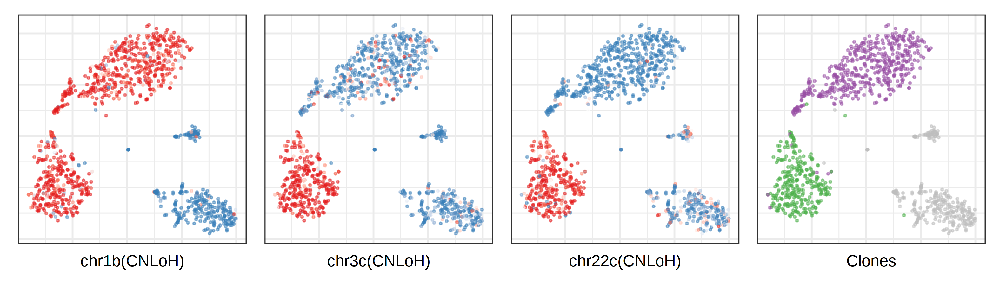

In [138]:
options(repr.plot.width = 10.5, repr.plot.height = 3, repr.plot.res = 300)
sample = 'TNBC1'

muts = c('1_2', '3_3', '22_3')
# cnv_states = c('22_3' = 'CNLOH', '3_3' = 'CNLOH', '4_3' = 'CNLOH', '15_1' = 'del', '1_1' = 'CNLOH')
cnv_states = res[[sample]]$joint_post %>% distinct(seg, cnv_state) %>% {setNames(.$cnv_state, .$seg)}

p_clones = con_TNBC$samples[[sample]]$plotEmbedding(
    alpha=0.5,
    size=0.5, 
    groups = res[[sample]]$clone_post %>%
        mutate(clone_opt = ifelse(clone_opt %in% c(5,6), 3, clone_opt)) %>%
        mutate(clone = c('1' = 'Normal', '3' = 'A', '4' = 'B')[as.character(clone_opt)]) %>%
        {setNames(.$clone, .$cell)},
    show.legend = F,
    mark.groups = F,
    plot.na = F,
    plot.theme = theme_bw(),
) +
labs(caption = 'Clones') +
scale_color_manual(values = c('Normal' = 'gray', 'A' = pal[3], 'B' = pal[4])) +
theme(plot.caption = element_text(hjust = 0.5, size = 12))

plist = list()

for (cnv in muts) {
    
    plist[[cnv]] = con_TNBC$samples[[sample]]$plotEmbedding(
        alpha=0.5,
        size=0.5,
        plot.na = F, 
        colors = res[[sample]]$joint_post %>%
            filter(seg == cnv) %>%
            mutate(p_cnv = ifelse(seg == '16_1', p_bamp, p_cnv)) %>%
            {setNames(.$p_cnv, .$cell)},
        show.legend = F,
        mark.groups = F,
        plot.theme = theme_bw(),
    ) +
    scale_color_gradient2(low = pal[2], mid = 'white', midpoint = 0.5, high = pal[1], limits = c(0,1)) +
    labs(caption = paste0('chr', rename_seg(cnv), '(', c('amp' = 'AMP', 'loh' = 'CNLoH', 'del' = 'DEL')[cnv_states[cnv]], ')')) +
    theme(plot.caption = element_text(hjust = 0.5, size = 12))
}

plist[[length(plist) + 1]] = p_clones

wrap_plots(plist, nrow = 1, legend = 'top') %>% do_plot('TNBC1_tsne', w = 10.5, h = 3)

### Probability legend

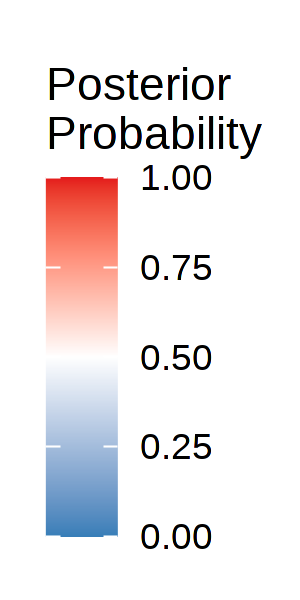

In [613]:
options(repr.plot.width = 1, repr.plot.height = 2, repr.plot.res = 300)

get_legend(
    plist[[cnv]] + theme(legend.position = 'right') +
        guides(color = guide_colorbar(title = 'Posterior\nProbability'))
) %>%
as_ggplot()

In [703]:
sample = 'TNBC1'

outdir = glue('~/paper_data/numbat_out/{sample}')
gexp.norm.long = fread(glue('{outdir}/gexp.norm.long.tsv.gz'))
hc = readRDS(glue('{outdir}/hc.rds'))

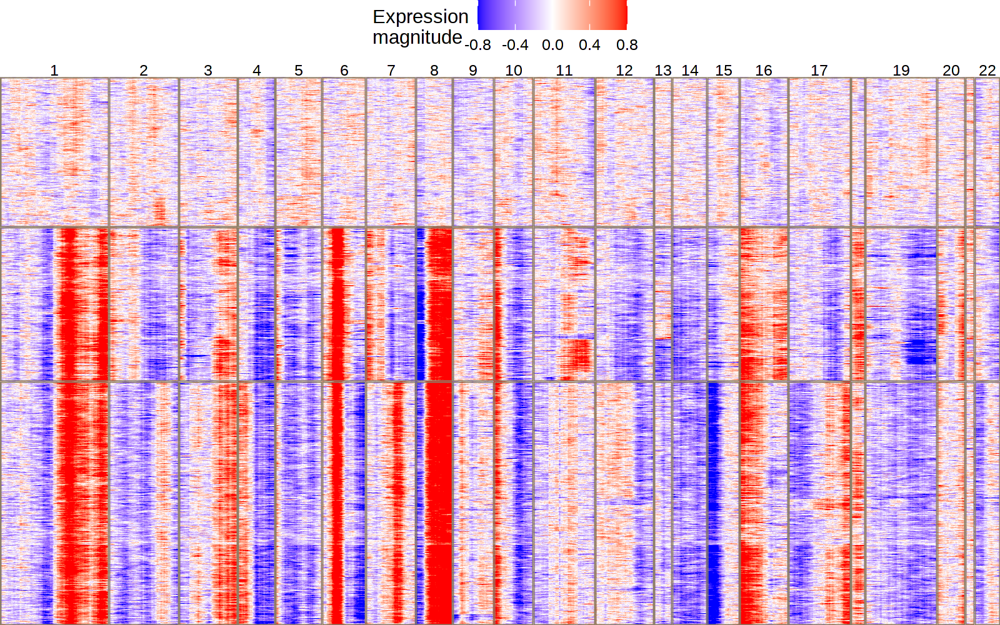

In [713]:
options(repr.plot.width = 8, repr.plot.height = 5, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

plot_sc_roll(
    gexp.norm.long,
    hc,
    k = 3,
    n_sample = 3000,
    plot_tree = FALSE
)

Warning message:
“Removed 65 rows containing missing values (geom_point).”


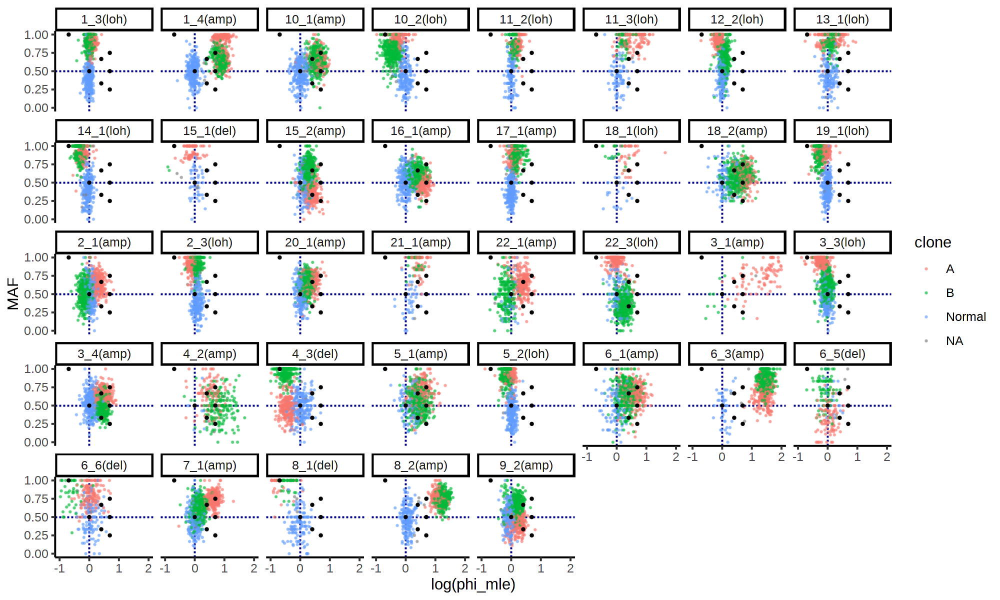

In [1591]:
options(repr.plot.width = 10, repr.plot.height = 6, repr.plot.res = 200)

D = res[[sample]]$exp_post %>% 
    left_join(
        res[[sample]]$allele_post %>% select(cell, seg, MAF, total),
        by = c("seg", "cell")
    ) %>%
    left_join(res[[sample]]$clone_post, by = 'cell') %>%
    mutate(clone = c('1' = 'Normal', '4' = 'A', '5' = 'B')[as.character(clone_opt)]) %>%
    left_join(cell_annot[[sample]], by = 'cell') %>%
    mutate(clone_opt = factor(clone_opt)) 

points = data.frame(
    phi_mle = c(1, 1.5, 1.5, 0.5, 2, 2, 2),
    MAF = c(0.5, 2/3, 1/3, 1, 0.5, 0.25, 0.75)
)

ggplot(
    D %>% filter(total > 5),
    aes(x = log(phi_mle), y = MAF, color = clone)
) +
geom_vline(xintercept = 0, color = 'darkblue', linetype = 'dashed') +
geom_hline(yintercept = 0.5, color = 'darkblue', linetype = 'dashed') +
geom_point(alpha = 0.5, size = 0.2) +
theme_classic() +
facet_wrap(~seg_label, nrow = 5) +
geom_point(
    data = points,
    inherit.aes = F,
    aes(x = log(phi_mle), y = MAF),
    size = 0.5
) +
xlim(-1,2)

# TNBC3

In [6]:
R.utils::sourceDirectory('~/Numbat/R')

sample = 'TNBC3'
out_dir = glue('~/paper_data/numbat_out/{sample}')
res[[sample]] = fetch_results(out_dir, i = 2)

# TNBC4

In [398]:
R.utils::sourceDirectory('~/Numbat/R')

sample = 'TNBC4'
out_dir = glue('~/paper_data/numbat_out/{sample}')
res[[sample]] = fetch_results(out_dir, i = 2)

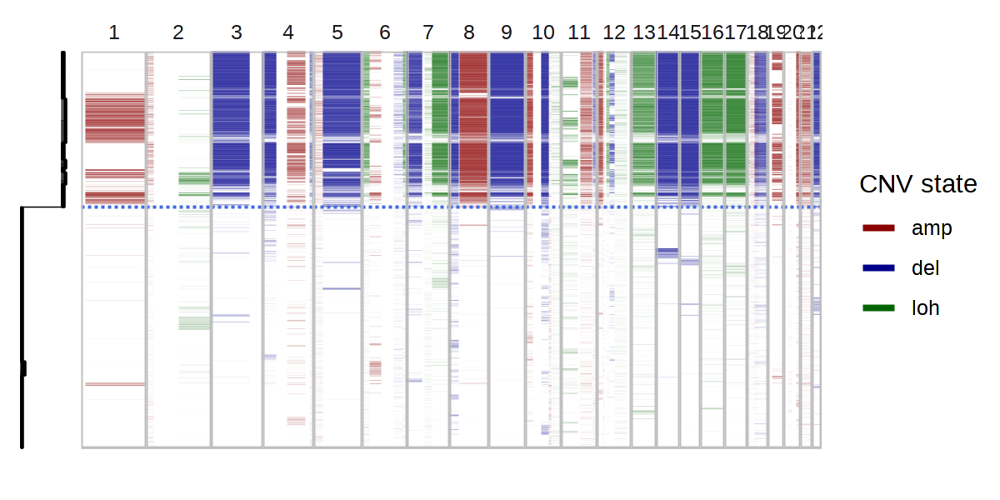

In [400]:
options(repr.plot.width = 8, repr.plot.height = 3, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

sample = 'TNBC4'

plot_sc_joint(
    res[[sample]]$gtree,
    res[[sample]]$joint_post,
    res[[sample]]$segs_consensus,
    tip_length = 1,
    branch_width = 0.2,
    size = 0.02,
    logBF_min = 0,
    logBF_max = 10
)

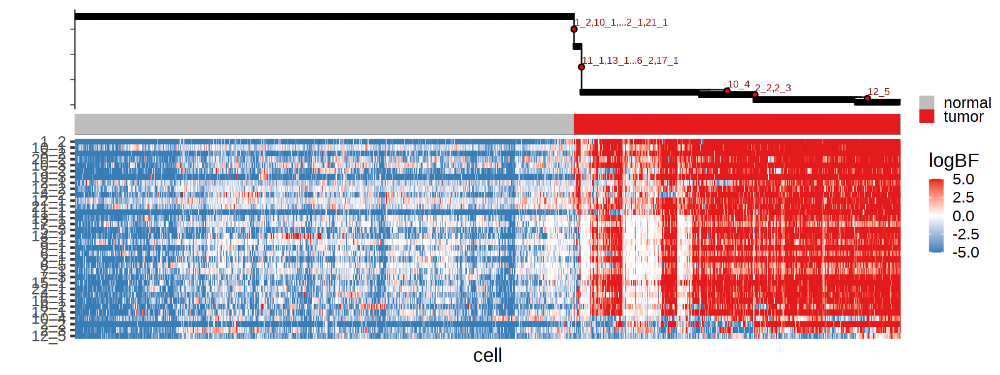

In [40]:
options(repr.plot.width = 8, repr.plot.height = 3, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

tree_heatmap(
    res[[sample]]$joint_post %>% filter(seg %in% colnames(res[[sample]]$geno)),
    res[[sample]]$gtree,
    branch_width = 0.3,
    tip = F,
    tip_length = 2,
    ratio = 0.5,
    tvn = TRUE,
    label_mut = TRUE,
    cnv_type = FALSE
) +
theme(plot.title = element_text(size = 8))

In [846]:
# options(repr.plot.width = 8, repr.plot.height = 3, repr.plot.res = 200)
# R.utils::sourceDirectory('~/Numbat/R')

# res[[sample]] %>% plot_clone_panel(ratio = 0.3)

In [153]:
segs_consensus = get_segs_consensus(bulk_subtrees)

In [845]:
# options(repr.plot.width = 20, repr.plot.height = 6, repr.plot.res = 200)
# R.utils::sourceDirectory('~/Numbat/R')

# plot_bulks(bulk_subtrees, ncol = 2)

# TNBC5

In [577]:
R.utils::sourceDirectory('~/Numbat/R')

sample = 'TNBC5'
out_dir = glue('~/paper_data/numbat_out/{sample}_new')
res[[sample]] = fetch_results(out_dir, i = 2)

In [1192]:
for (sample in samples) {
    tree_post = res[[sample]]$tree_post
    max_cost = 400

    G_m = get_mut_tree(tree_post$gtree, tree_post$mut_nodes)  %>% 
                simplify_history(tree_post$l_matrix, max_cost = max_cost) %>% 
                label_genotype()

    mut_nodes = G_m %>% igraph::as_data_frame('vertices') %>% 
        select(name = node, site = label, clone = clone, GT = GT)

    # update tree
    gtree = mut_to_tree(tree_post$gtree, mut_nodes)
    res[[sample]]$gtree = mark_tumor_lineage(gtree)
}

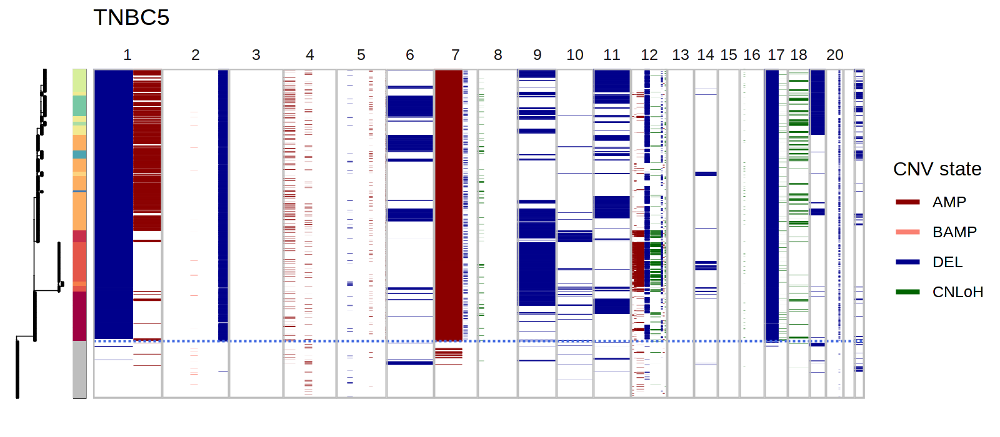

In [572]:
options(repr.plot.width = 8, repr.plot.height = 3.5, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

sample = 'TNBC5'

plot_sc_joint(
    res[[sample]]$gtree,
    res[[sample]]$joint_post %>% mutate(cnv_state = ifelse(cnv_state == 'bdel', 'del', cnv_state)),
    res[[sample]]$segs_consensus,
    tip_length = 0.5,
    branch_width = 0.2,
    size = 0.1,
    logBF_min = 2,
    logBF_max = 5,
#     cell_dict = cell_annot[[sample]] %>% {setNames(.$cluster.pred, .$cell)},
    clone_bar = T,
    clone_legend = F
) +
ggtitle(sample)

Scale for 'y' is already present. Adding another scale for 'y', which will
replace the existing scale.



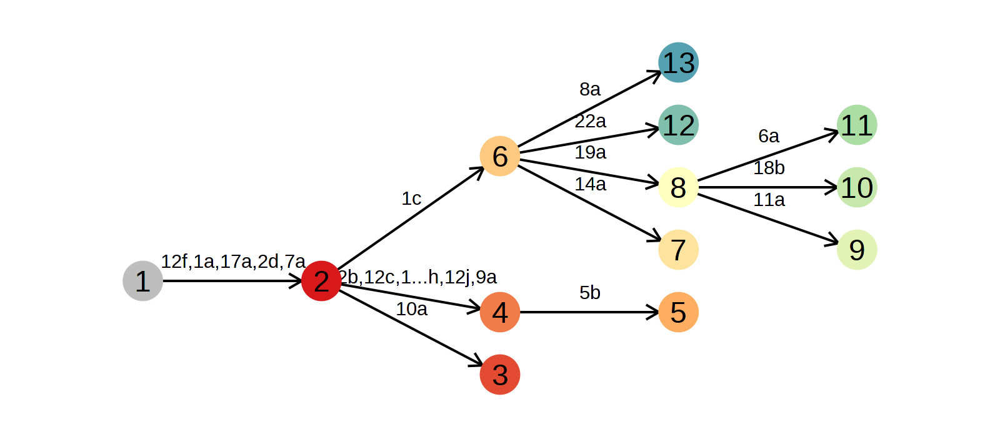

In [565]:
sample = 'TNBC5'
res[[sample]]$G_m %>% plot_mut_history()

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.



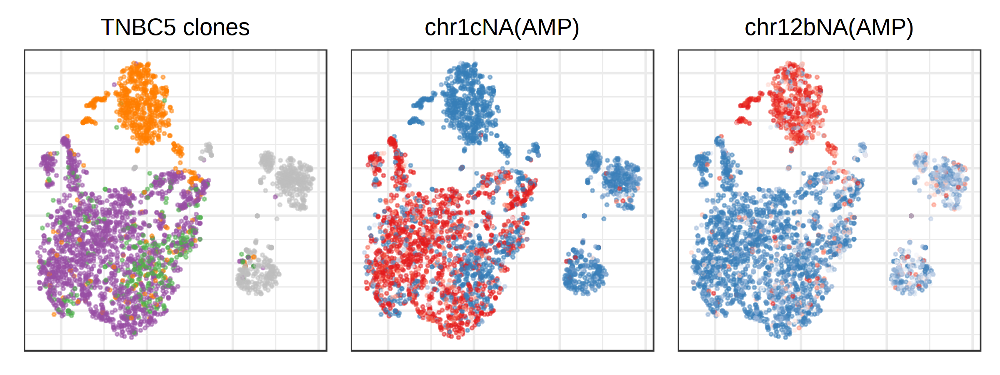

In [584]:
options(repr.plot.width = 8, repr.plot.height = 3, repr.plot.res = 300)
sample = 'TNBC5'
# muts = c('1_7', '12_1')
muts = c('1c', '12b')
# cnv_states = c('22_3' = 'CNLOH', '3_3' = 'CNLOH', '4_3' = 'CNLOH', '15_1' = 'del', '1_1' = 'CNLOH')
cnv_states = res[[sample]]$joint_post %>% distinct(seg, cnv_state) %>% {setNames(.$cnv_state, .$seg)}
getPalette = colorRampPalette(RColorBrewer::brewer.pal(n = 10, 'Spectral'))

p_clones = con_TNBC$samples[[sample]]$plotEmbedding(
    alpha=0.5,
    size=0.5, 
    groups = res[[sample]]$clone_post %>%
        mutate(clone = case_when(
            clone_opt == 1 ~ 'Normal',
#             clone_opt %in% 2 ~ 'Truncal',
#             clone_opt %in% 3:9 ~ 'Major',
#             clone_opt %in% 10:14 ~ 'Minor'
            clone_opt %in% 2:3 ~ 'Truncal',
            clone_opt %in% 6:13 ~ 'Major',
            clone_opt %in% 4:5 ~ 'Minor'
        )) %>%
        {setNames(.$clone, .$cell)},
    show.legend = F,
    mark.groups = F,
    plot.na = F,
    plot.theme = theme_bw(),
    title = paste0(sample, ' clones'),
#     pal = c('gray', getPalette(length(unique(res[[sample]]$clone_post$clone_opt))-1)),
    pal = c('Normal' = 'gray', 'Truncal' = pal[3], 'Major' = pal[4], 'Minor' = pal[5])
) +
theme(plot.title = element_text(hjust = 0.5))

plist = list()
plist[[1]] = p_clones

for (mut in muts) {
    
    plist[[mut]] = con_TNBC$samples[[sample]]$plotEmbedding(
        alpha=0.5,
        size=0.5, 
        plot.na = F, 
        colors = res[[sample]]$joint_post %>%
            left_join(res[[sample]]$clone_post %>% select(clone_opt, cell), by = 'cell') %>%
            filter(seg == mut) %>%
            {setNames(.$p_cnv - 0.5, .$cell)},
        show.legend = F,
        mark.groups = F,
        plot.theme = theme_bw(),
        title = paste0('chr', rename_seg(mut), '(', toupper(cnv_states[mut]), ')')
#         title = mut
    ) +
    scale_color_gradient2(low = pal[2], mid = 'white', high = pal[1]) +
    theme(plot.title = element_text(hjust = 0.5))
}

wrap_plots(plist, nrow = 1, legend = 'top')

# ATC1

In [22]:
R.utils::sourceDirectory('~/Numbat/R')

out_dir = glue('~/paper_data/numbat_out/{sample}')
nb[[sample]] = Numbat$new(out_dir, i = 2, old_index = TRUE)

In [1490]:
bulk_clones = fread('~/paper_data/numbat_out/TNBC1/bulk_clones_2.tsv.gz')

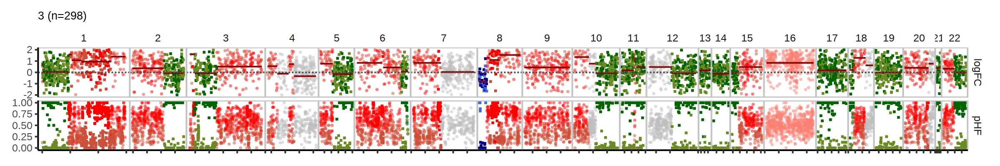

In [1491]:
options(repr.plot.width = 12, repr.plot.height = 2, repr.plot.res = 200)

bulk_clones %>% 
filter(sample == 3) %>% 
plot_bulks()

In [874]:
R.utils::sourceDirectory('~/Numbat/R')

joint_post = get_joint_post(
    res[[sample]]$exp_post,
    res[[sample]]$allele_post,
    res[[sample]]$segs_consensus %>% 
        mutate(p_loh = 1/3, p_amp = 1/3, p_del = 1/3)
)

In [714]:
sample = 'ATC1'

outdir = glue('~/paper_data/numbat_out/{sample}')
gexp.norm.long = fread(glue('{outdir}/gexp.norm.long.tsv.gz'))
hc = readRDS(glue('{outdir}/hc.rds'))

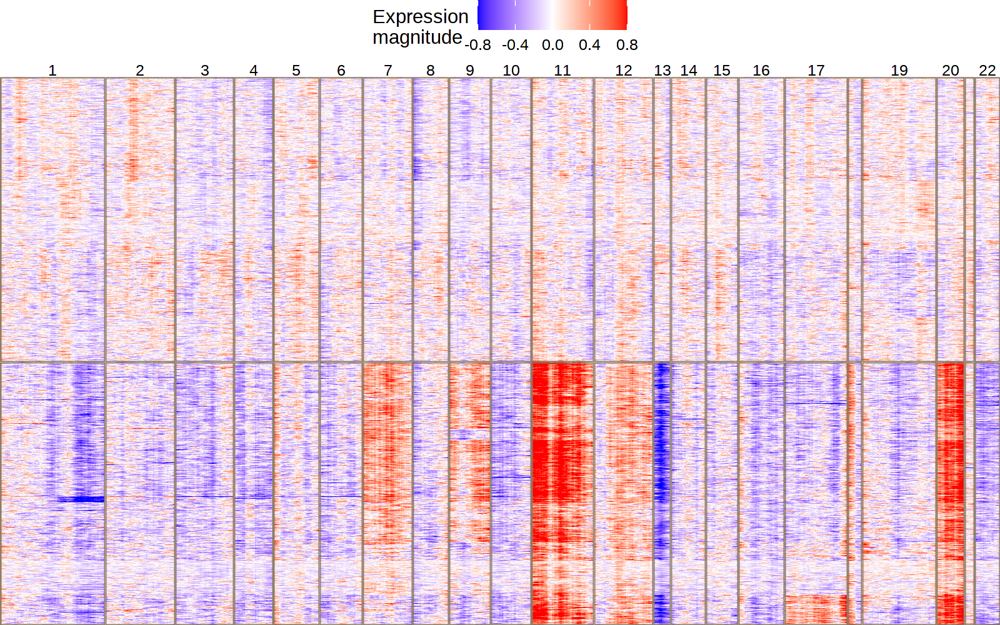

In [717]:
options(repr.plot.width = 8, repr.plot.height = 5, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

plot_sc_roll(
    gexp.norm.long,
    hc,
    k = 2,
    n_sample = 1e4,
#     n_sample = 100,
    plot_tree = F
)

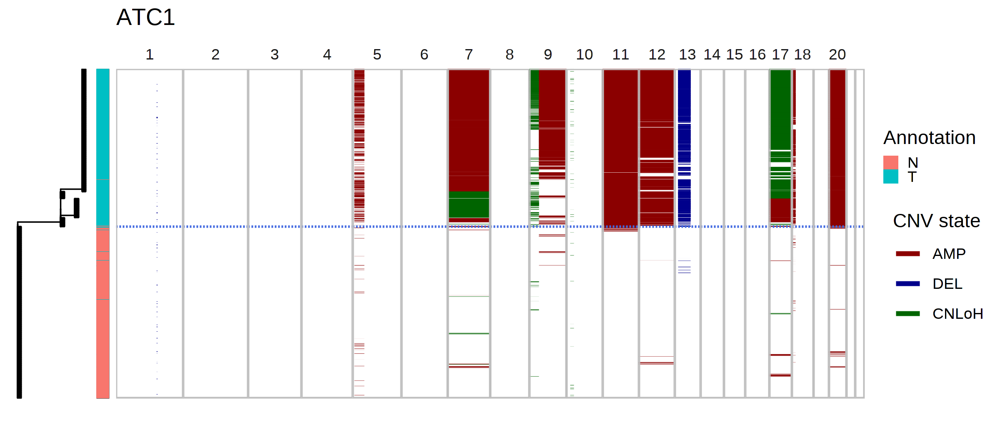

In [731]:
options(repr.plot.width = 8, repr.plot.height = 3.5, repr.plot.res = 300)
R.utils::sourceDirectory('~/Numbat/R')
sample = 'ATC1'

p = plot_sc_joint(
    res[[sample]]$gtree,
    res[[sample]]$joint_post,
    res[[sample]]$segs_consensus,
    tip_length = 0.5,
    branch_width = 0.3,
    size = 0.1,
    logBF_min = 2,
    logBF_max = 5,
    cell_dict = cell_annot[[sample]] %>% {setNames(.$cluster.pred, .$cell)},
    clone_bar = F,
    tree_height = 1.5,
    multi_allelic = TRUE
) +
theme(axis.title.x = element_blank()) +
ggtitle(sample) &
theme(plot.background = element_rect(fill = "transparent", color = NA))

ggsave("~/figures/ATC1_phylogeny.png", p, bg = "transparent", width = 8, height = 3.5, dpi = 300)

p

Retesting CNVs..

Finishing..

Warning message:
“Removed 139682 rows containing missing values (geom_point).”


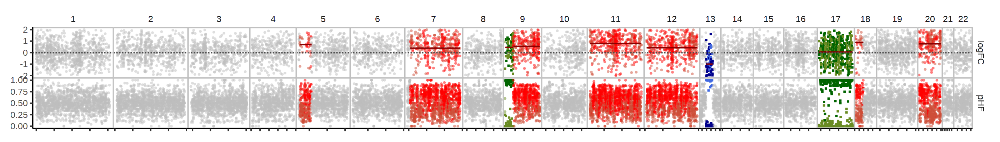

In [244]:
options(repr.plot.width = 14, repr.plot.height = 2, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

bulk = res[[sample]]$bulk_clones %>%
    filter(sample %in% 4) %>%
    analyze_bulk(find_diploid = F, lambda = 2, t = 1e-6) 

bulk %>%
plot_bulks(phi_mle = TRUE, legend = F, title = F)

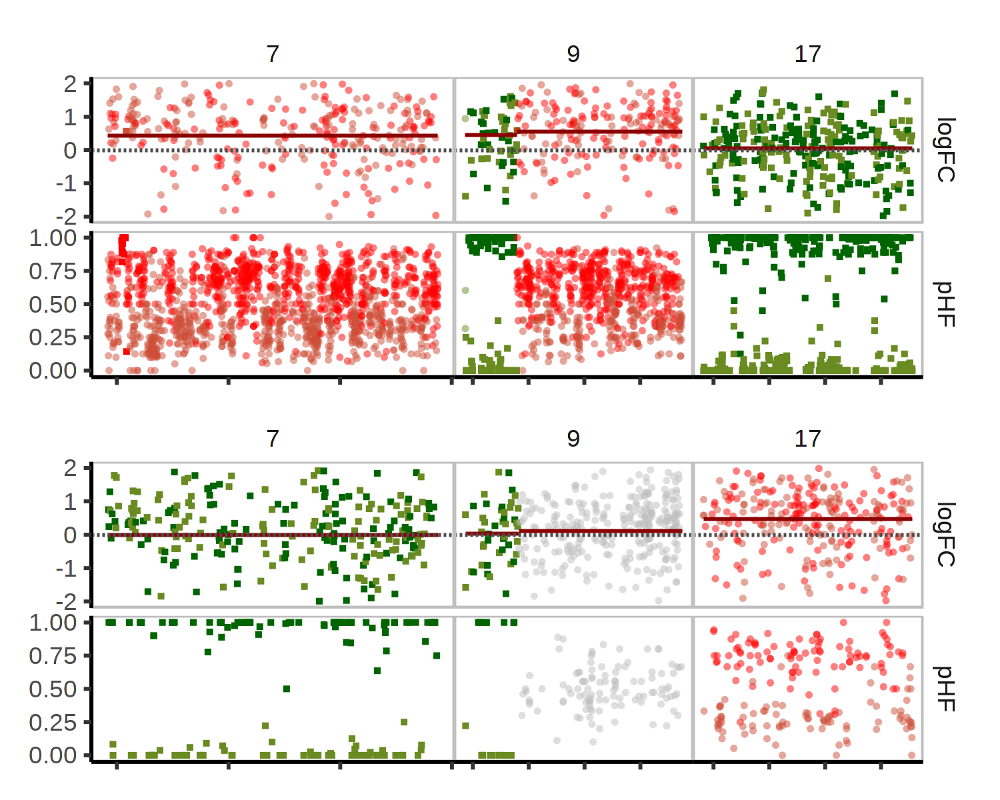

In [35]:
options(repr.plot.width = 5, repr.plot.height = 4, repr.plot.res = 300)
R.utils::sourceDirectory('~/Numbat/R')

sample = 'ATC1'
res[[sample]]$bulk_clones %>% 
filter(sample %in% c(3,4)) %>%
mutate(sample = factor(sample, c(4,3))) %>%
filter(CHROM %in% c(7, 9, 17)) %>%
group_by(sample, seg) %>%
mutate(
    approx_lik_exp(
        Y_obs[!is.na(Y_obs)], lambda_ref[!is.na(Y_obs)], unique(na.omit(d_obs)),
        mu = mu[!is.na(Y_obs)],
        sig = sig[!is.na(Y_obs)]
    )
) %>%
plot_bulks(phi_mle = TRUE, legend = F, title = F)

Joining, by = "cell"

Warning message:
“Removed 189 rows containing missing values (geom_point).”


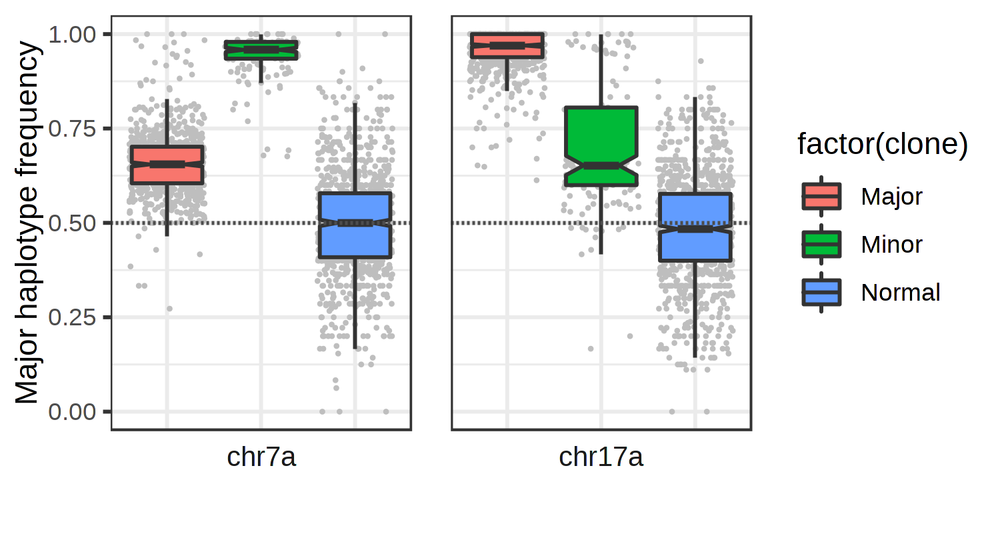

In [668]:
options(repr.plot.width = 5, repr.plot.height = 2.7, repr.plot.res = 300)
R.utils::sourceDirectory('~/Numbat/R')

sample = 'ATC1'
segs = c('7_1', '17_1')
clone_dict = c('4' = 'Major', '3' = 'Minor', '1' = 'Normal')

res[[sample]]$allele_post %>% 
filter(seg %in% segs) %>%
mutate(seg = factor(seg, segs)) %>%
arrange(seg) %>%
mutate(seg = paste0('chr', sapply(seg, function(seg) {rename_seg(seg)}))) %>%
mutate(seg = factor(seg, unique(seg))) %>%
left_join(
    res[[sample]]$clone_post %>%
        select(clone = clone_opt, cell = cell)
) %>%
mutate(clone = clone_dict[as.character(clone)]) %>%
filter(!is.na(clone)) %>%
filter(total >= 5) %>%
ggplot(
    aes(x = clone, y = MAF, fill = factor(clone))
) +
theme_bw() +
geom_jitter(size = 0.1, color = 'gray') +
geom_boxplot(alpha = 1, notch = T, outlier.alpha = 0) +
geom_hline(yintercept = 0.5, linetype = 'dashed', color = 'gray30') +
# geom_hline(yintercept = 0.66, linetype = 'dashed', color = 'royalblue') +
# geom_hline(yintercept = 0.33, linetype = 'dashed', color = 'royalblue') +
# ggtitle('chr9') +
facet_wrap(~seg, strip.position = 'bottom') +
theme(
#     strip.background = element_rect(size = 0, fill = NULL)
    strip.background = element_blank(),
    panel.spacing = unit(0.5, 'cm'),
    strip.text = element_text(size = 10),
    axis.ticks.x = element_blank(),
    axis.text.x = element_blank(),
    plot.caption = element_text(hjust = 0)
) +
# scale_fill_manual(
#     values = c('Normal' = 'gray', 'Minor' = pal[3], 'Major' = pal[4]),
#     name = 'Clone'
# ) +
ylim(0,1) +
ylab('Major haplotype frequency') +
xlab('')

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.



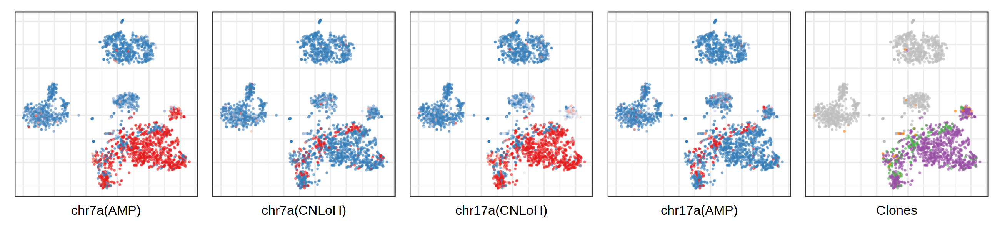

In [449]:
options(repr.plot.width = 13, repr.plot.height = 3, repr.plot.res = 200)
sample = 'ATC1'
con_sample = con_ATC$samples[[sample]]

getPalette = colorRampPalette(RColorBrewer::brewer.pal(n = 5, 'Spectral'))

plot_list = list()

cnvs = c('7_1_amp', '7_1_loh', '17_1_loh', '17_1_amp')

joint_post = expand_states(res[[sample]]$joint_post, res[[sample]]$segs_consensus)

for (cnv in cnvs) {

    plot_list[[cnv]] = con_sample$plotEmbedding(
            plot.na = F, 
            alpha = 0.5,
            size = 0.3,
            colors = joint_post %>% 
                filter(seg == cnv) %>%
                {setNames(.$p_cnv, .$cell)},
            mark.groups = F,
            plot.theme = theme_bw()
        ) +
        scale_color_gradient2(low = pal[2], mid = 'white', high = pal[1], midpoint = 0.5) +
        labs(caption = paste0('chr', rename_seg(cnv), '(', c('amp' = 'AMP', 'loh' = 'CNLoH', 'del' = 'DEL')[str_extract(cnv, 'amp|loh|del')], ')')) +
        theme(plot.caption = element_text(hjust = 0.5, size = 12))
}


plot_list[[length(plot_list)+1]] = con_sample$plotEmbedding(
    plot.na = F, 
    alpha = 0.5,
    size = 0.3,
    palette = c('gray', pal[5], pal[3], pal[4]),
    groups = res[[sample]]$clone_post %>%
        {setNames(.$clone_opt, .$cell)},
    mark.groups = F
) +
labs(caption = 'Clones') +
theme(plot.caption = element_text(hjust = 0.5, size = 12))
# guides(colour = guide_legend(override.aes = list(size = 2)))

wrap_plots(plot_list, nrow = 1)

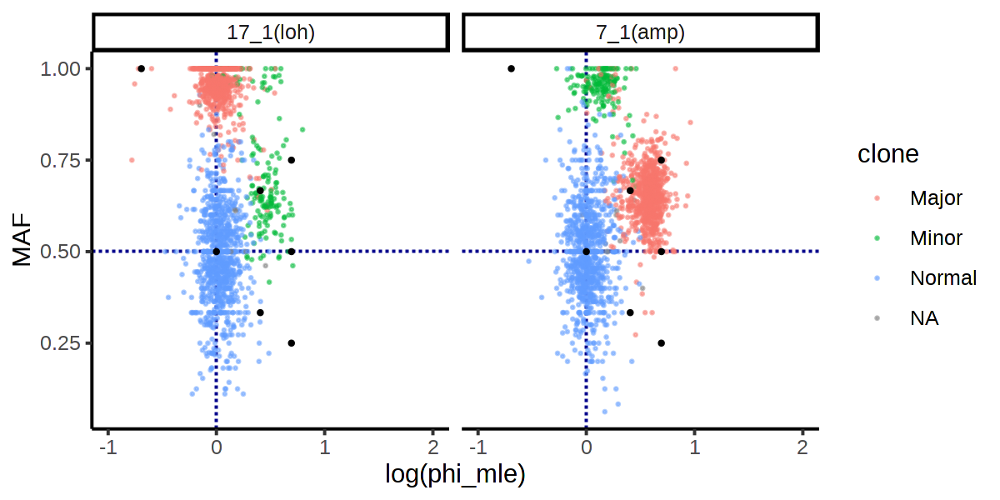

In [674]:
options(repr.plot.width = 6, repr.plot.height = 3, repr.plot.res = 200)

D = res[[sample]]$exp_post %>% 
    filter(seg %in% segs) %>%
    left_join(
        res[[sample]]$allele_post %>% select(cell, seg, MAF, total),
        by = c("seg", "cell")
    ) %>%
    left_join(res[[sample]]$clone_post, by = 'cell') %>%
    mutate(clone = clone_dict[as.character(clone_opt)]) %>%
    left_join(cell_annot[[sample]], by = 'cell') %>%
    mutate(clone_opt = factor(clone_opt)) 

points = data.frame(
    phi_mle = c(1, 1.5, 1.5, 0.5, 2, 2, 2),
    MAF = c(0.5, 2/3, 1/3, 1, 0.5, 0.25, 0.75)
)

ggplot(
    D %>% filter(total >= 8),
    aes(x = log(phi_mle), y = MAF, color = clone)
) +
geom_vline(xintercept = 0, color = 'darkblue', linetype = 'dashed') +
geom_hline(yintercept = 0.5, color = 'darkblue', linetype = 'dashed') +
geom_point(alpha = 0.5, size = 0.2) +
theme_classic() +
facet_wrap(~seg_label, nrow = 1) +
geom_point(
    data = points,
    inherit.aes = F,
    aes(x = log(phi_mle), y = MAF),
    size = 0.5
) +
xlim(-1,2)

# ATC2

In [418]:
R.utils::sourceDirectory('~/Numbat/R')

sample = 'ATC2_subsampled'
res[['ATC2']] = fetch_results(glue('~/paper_data/numbat_out/{sample}'), i = 2)

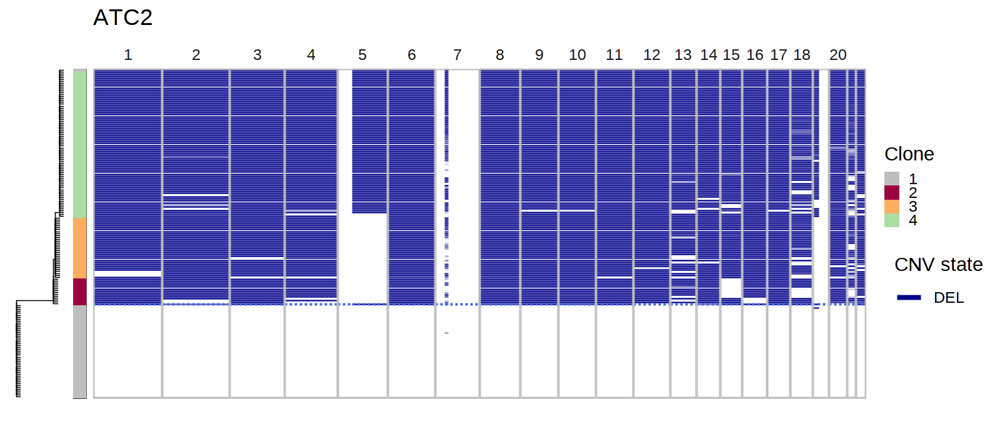

In [379]:
options(repr.plot.width = 8, repr.plot.height = 3.5, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

sample = 'ATC2'

plot_sc_joint(
    res[[sample]]$gtree,
    res[[sample]]$joint_post,
    res[[sample]]$segs_consensus,
    tip_length = 2,
    branch_width = 0.2,
    size = 0.3,
    clone_bar = T,
#     cell_dict = cell_annot[['ATC2']] %>% {setNames(.$cluster.pred, .$cell)},
#     pal_clone = c('gray', pal[3], pal[4])
) +
ggtitle('ATC2')

In [100]:
R.utils::sourceDirectory('~/Numbat/R')

sample = 'ATC2'
res[[sample]] = fetch_results(glue('~/paper_data/numbat_out/{sample}'), i = 2)

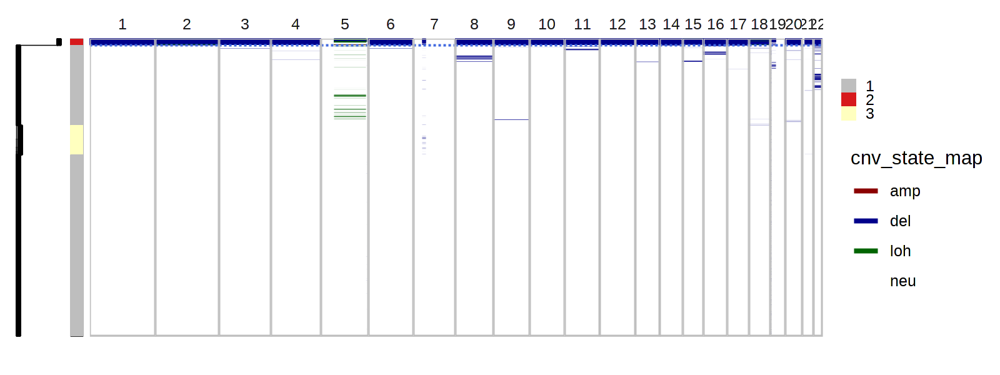

In [101]:
options(repr.plot.width = 8, repr.plot.height = 3, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

plot_sc_joint(
    res[[sample]]$gtree,
    res[[sample]]$joint_post,
    res[[sample]]$segs_consensus,
    tip_length = 2,
    branch_width = 0.2,
    size = 0.1,
    logBF_min = 2,
    logBF_max = 10,
    clone_bar = T
)

Warning message:
“Removed 117483 rows containing missing values (geom_point).”
Warning message:
“Removed 87967 rows containing missing values (geom_point).”
Warning message:
“Removed 56200 rows containing missing values (geom_point).”
Warning message:
“Removed 45542 rows containing missing values (geom_point).”
Warning message:
“Removed 66839 rows containing missing values (geom_point).”


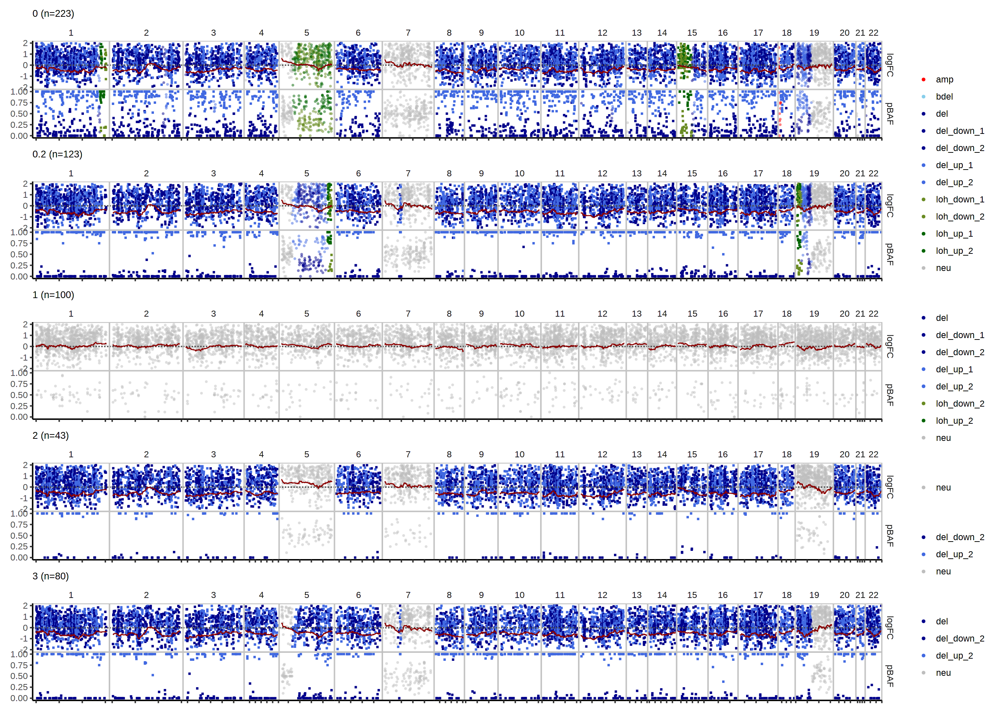

In [544]:
options(repr.plot.width = 14, repr.plot.height = 10, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

plot_bulks(bulk0)

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Warning message:
“Removed 1 rows containing missing values (geom_point).”


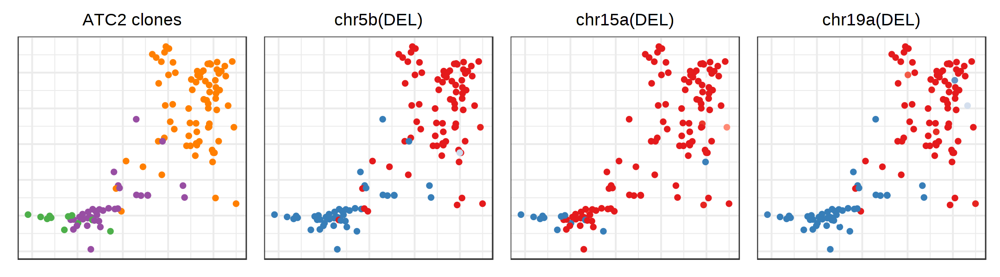

In [683]:
options(repr.plot.width = 10.8, repr.plot.height = 3, repr.plot.res = 200)
sample = 'ATC2'
muts = c('5b', '15a', '19a')
# cnv_states = c('22_3' = 'CNLOH', '3_3' = 'CNLOH', '4_3' = 'CNLOH', '15_1' = 'del', '1_1' = 'CNLOH')
cnv_states = res[[sample]]$joint_post %>% distinct(seg, cnv_state) %>% {setNames(.$cnv_state, .$seg)}
getPalette = colorRampPalette(RColorBrewer::brewer.pal(n = 4, 'Spectral'))

p_clones = con_ATC$samples[[sample]]$plotEmbedding(
        alpha=1,
        size=1.5, 
    groups = res[[sample]]$clone_post %>%
        filter(!clone_opt %in% c(1)) %>%
#         mutate(clone = c('1' = 'Normal', '4' = 'A', '5' = 'B')[as.character(clone_opt)]) %>%
        {setNames(.$clone_opt, .$cell)},
    show.legend = F,
    mark.groups = F,
    plot.na = F,
    plot.theme = theme_bw(),
    title = paste0(sample, ' clones'),
#     pal = c(getPalette(length(unique(res[[sample]]$clone_post$clone))))
    pal = c(NA, pal[3], pal[4], pal[5])
) +
theme(plot.title = element_text(hjust = 0.5))
# scale_color_manual(values = c('Normal' = 'gray', 'A' = pal[3], 'B' = pal[4]))

plist = list()
plist[['clones']] = p_clones

for (mut in muts) {
    
    plist[[mut]] = con_ATC$samples[[sample]]$plotEmbedding(
        alpha=1,
        size=1.5, 
        plot.na = F, 
        colors = res[[sample]]$joint_post %>%
            left_join(res[[sample]]$clone_post %>% select(clone_opt, cell), by = 'cell') %>%
            filter(!clone_opt %in% c(1)) %>%
            filter(seg == mut) %>%
            {setNames(.$p_cnv - 0.5, .$cell)},
        show.legend = F,
        mark.groups = F,
        plot.theme = theme_bw(),
        title = paste0('chr', str_remove(mut, '_'), '(', toupper(cnv_states[mut]), ')')
#         title = mut
    ) +
    scale_color_gradient2(low = pal[2], mid = 'white', high = pal[1]) +
    theme(plot.title = element_text(hjust = 0.5))

}

wrap_plots(plist, nrow = 1, legend = 'top')

# ATC3

In [765]:
R.utils::sourceDirectory('~/Numbat/R')

sample = 'ATC3'
out_dir = glue('~/paper_data/numbat_out/{sample}')
nb[[sample]] = Numbat$new(out_dir, i = 2, old_index = T)

Could not read the input file ~/paper_data/numbat_out/ATC3/gexp_roll_wide.tsv.gz with data.table::fread(). Please check that the file is valid.



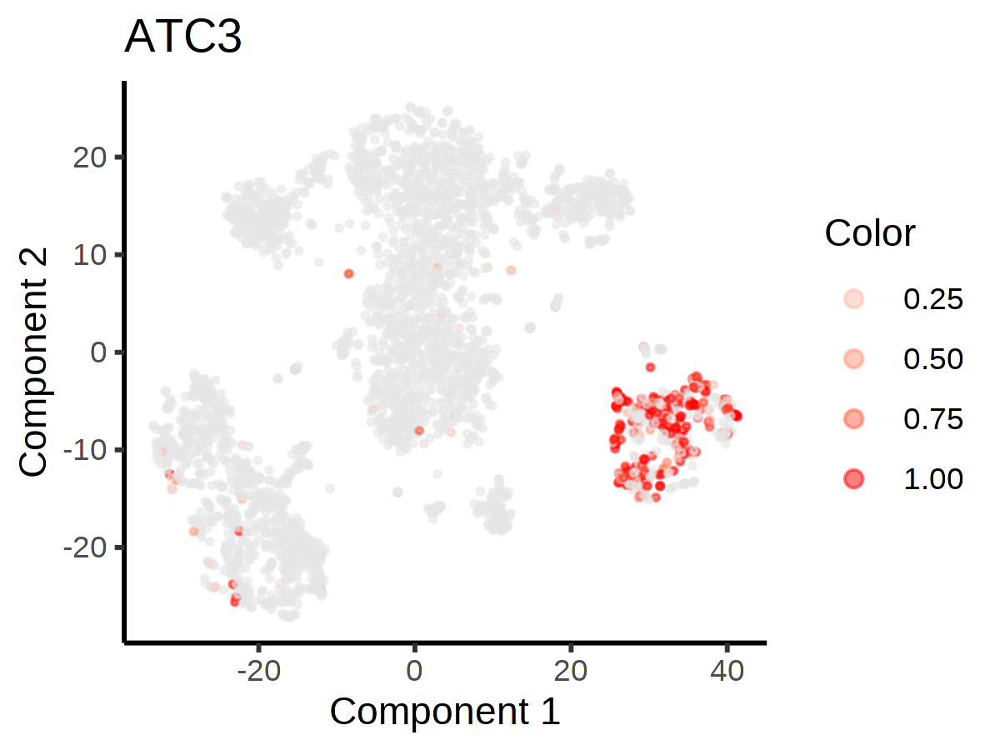

In [1233]:
options(repr.plot.width = 4, repr.plot.height = 3, repr.plot.res = 300)
sample = 'ATC3'
con_ATC$samples[[sample]]$plotEmbedding(
    plot.na = F, 
    alpha = 0.5,
    size = 0.5,
    color = res[[sample]]$joint_post %>% 
        filter(seg == '6_2') %>%
        {setNames(.$p_cnv, .$cell)},
    mark.groups = F,
    title = sample
) +
theme_classic() +
guides(colour = guide_legend(override.aes = list(size = 2)))

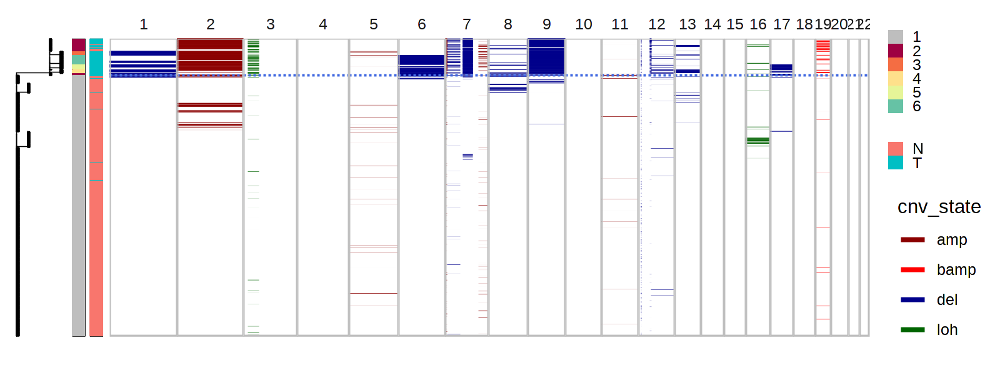

In [663]:
options(repr.plot.width = 8, repr.plot.height = 3, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

plot_sc_joint(
    res[[sample]]$gtree,
    res[[sample]]$joint_post,
    res[[sample]]$segs_consensus,
    branch_width = 0.2,
    size = 0.1,
    logBF_min = 2,
    logBF_max = 5,
    cell_dict = cell_annot[[sample]] %>% {setNames(.$cluster.pred, .$cell)},
    clone_bar = T
)

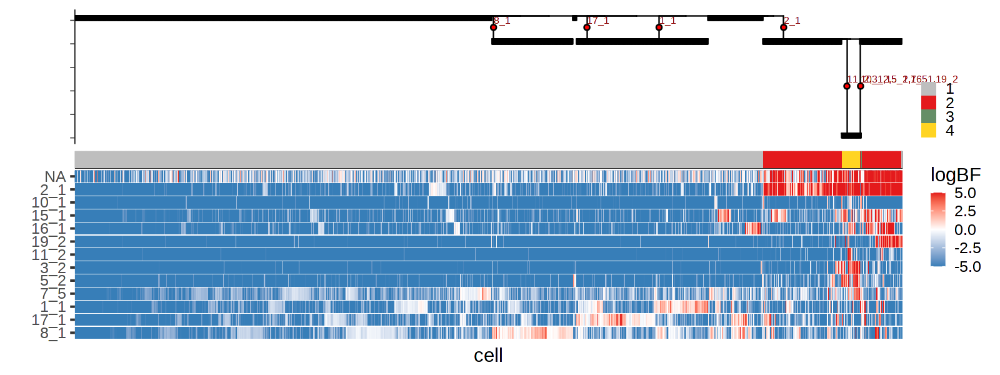

In [585]:
options(repr.plot.width = 8, repr.plot.height = 3, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')
sample = 'ATC3'
tree_heatmap(
    res[[sample]]$joint_post,
    res[[sample]]$gtree,
    branch_width = 0.3,
    tip = F,
    tip_length = 0.1,
    ratio = 0.8,
    tvn = F,
    label_mut = T,
    cnv_type = F
) +
theme(plot.title = element_text(size = 8))

Warning message:
“Removed 109907 rows containing missing values (geom_point).”
Warning message:
“Removed 78436 rows containing missing values (geom_point).”
Warning message:
“Removed 95662 rows containing missing values (geom_point).”
Warning message:
“Removed 37928 rows containing missing values (geom_point).”
Warning message:
“Removed 68122 rows containing missing values (geom_point).”


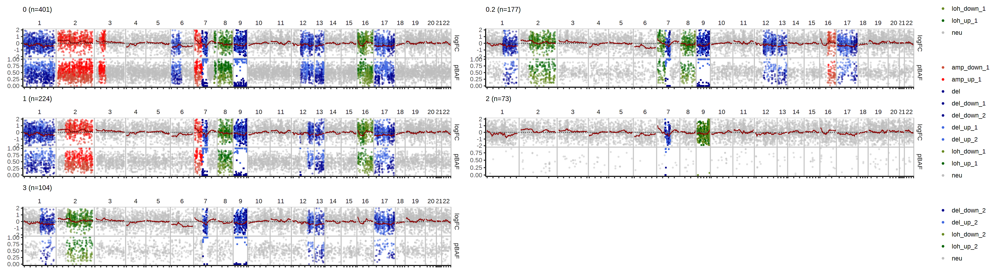

In [19]:
options(repr.plot.width = 20, repr.plot.height = 5.5, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

plot_bulks(bulk0, ncol = 2)

In [80]:
segs_consensus = get_segs_consensus(bulk_subtrees)

In [186]:
G_m = mut_tree_file %>% 
    read_mut_tree(tree_post$mut_nodes) %>%
    simplify_history(tree_post$l_matrix, max_cost = 150) %>%
    label_genotype()

mut_nodes = G_m %>% as_data_frame('vertices') %>% select(name = node, site = label)

# update tree
gtree = mut_to_tree(tree_post$gtree, mut_nodes)

opt_move:7_4->9_2, cost=2.91

opt_move:13_2->17_2, cost=6.37

opt_move:6_2->13_2,17_2, cost=88.4

opt_move:12_2->7_2, cost=143

Seems like we're catching a real event in the adjacent normal cells

In [88]:
segs_consensus = get_segs_consensus(bulk_subtrees)

Warning message:
“Using alpha for a discrete variable is not advised.”
Warning message:
“Removed 6691 rows containing missing values (geom_point).”


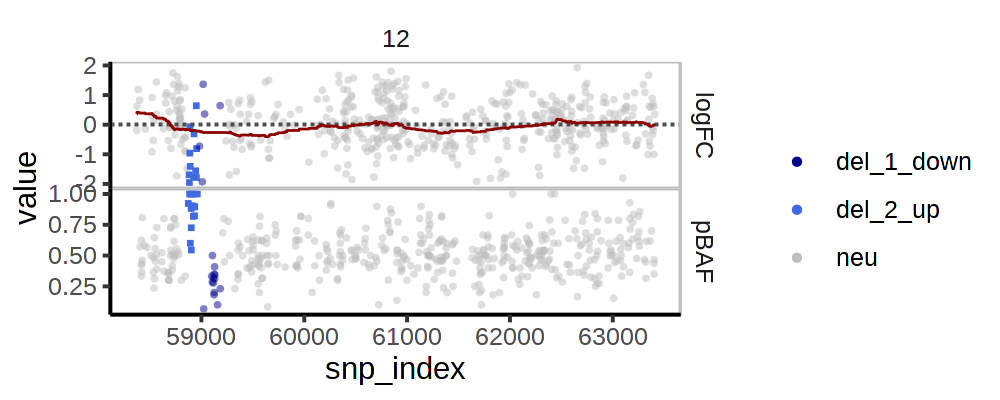

In [126]:
options(repr.plot.width = 5, repr.plot.height = 2, repr.plot.res = 200)

bulk_clones %>% filter(sample == 2) %>% filter(CHROM == 12) %>% plot_psbulk()

Warning message:
“Using alpha for a discrete variable is not advised.”
Warning message:
“Removed 7810 rows containing missing values (geom_point).”


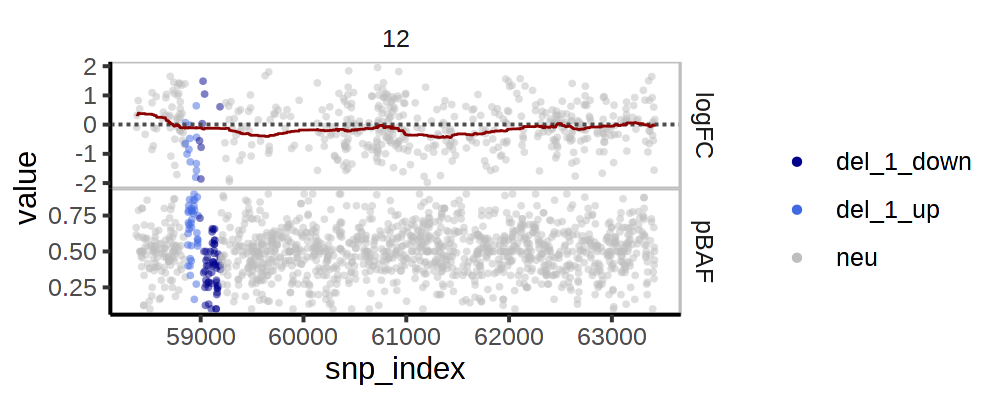

In [124]:
options(repr.plot.width = 5, repr.plot.height = 2, repr.plot.res = 200)

bulk %>% filter(CHROM == 12) %>% plot_psbulk()

In [188]:
cell_sample = colnames(geno)

# ATC4

In [1233]:
R.utils::sourceDirectory('~/Numbat/R')

sample = 'ATC4'
out_dir = glue('~/paper_data/numbat_out/{sample}')
res[[sample]] = fetch_results(out_dir, i = 2)

# ATC5

In [532]:
R.utils::sourceDirectory('~/Numbat/R')

sample = 'ATC5'
out_dir = glue('~/paper_data/numbat_out/{sample}')
# out_dir = glue('~/results/MDA/{sample}')
res[[sample]] = fetch_results(out_dir, i = 2)

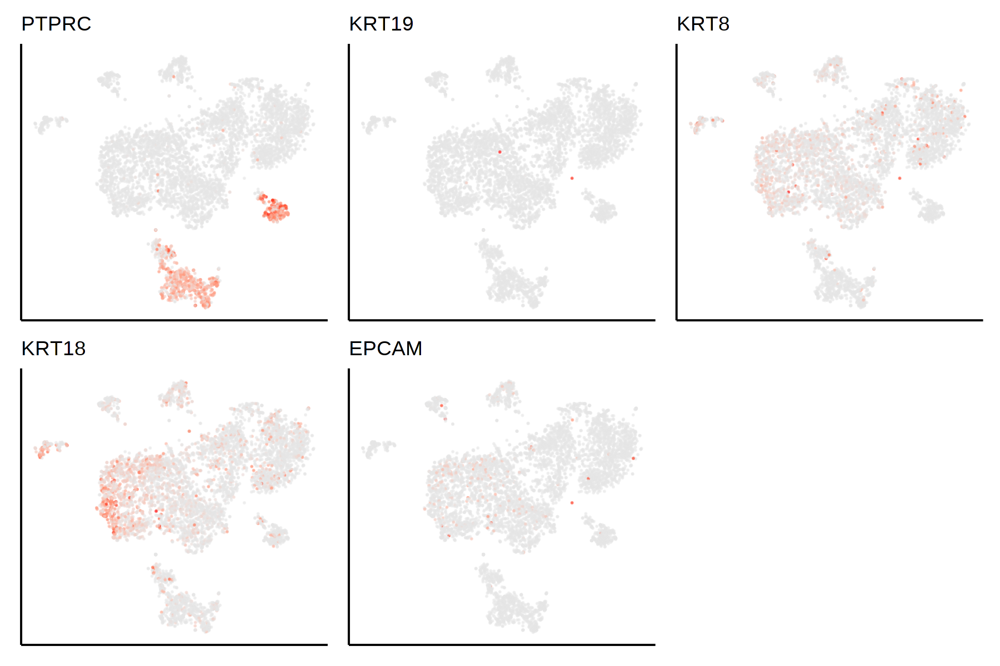

In [542]:
options(repr.plot.width = 9, repr.plot.height = 6, repr.plot.res = 200)

con_sample = con_ATC$samples[[sample]]

pal = RColorBrewer::brewer.pal(n = 8, 'Set1')

lapply(
    c('PTPRC', 'KRT19', 'KRT8', 'KRT18', 'EPCAM'),
    function(gene) {
        con_sample$plotEmbedding(
            plot.na = F, 
            size = 0.1,
            alpha = 0.5,
            gene = gene,
            mark.groups = F,
            title = gene,
            plot.theme = theme_classic()
        )
    }
) %>% wrap_plots(nrow = 2)

In [508]:
chrom_sizes = fread('~/ref/hg38.chrom.sizes.txt') %>% 
    setNames(c('CHROM', 'size')) %>%
    mutate(CHROM = str_remove(CHROM, 'chr')) %>%
    filter(CHROM %in% 1:22) %>%
    mutate(CHROM = factor(CHROM))

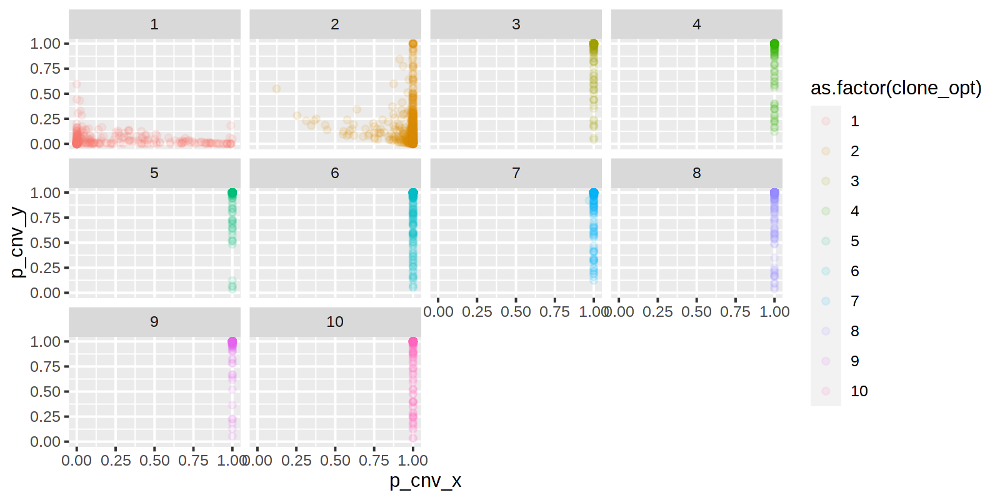

In [539]:
ggplot(
    res[[sample]]$clone_post,
    aes(x = p_cnv_x, y = p_cnv_y, color = as.factor(clone_opt))
) +
geom_point(alpha = 0.1) +
facet_wrap(~clone_opt)

In [1596]:
# options(repr.plot.width = 8, repr.plot.height = 5, repr.plot.res = 200)
# R.utils::sourceDirectory('~/Numbat/R')

# sample = 'ATC5'

# tree_heatmap(
#     res[[sample]]$joint_post,
#     res[[sample]]$gtree,
#     branch_width = 0.3,
#     tip = F,
#     tip_length = 0.1,
#     ratio = 0.8,
#     tvn = F,
#     label_mut = T,
#     cnv_type = F
# ) +
# theme(plot.title = element_text(size = 8))

In [167]:
library(logger)
library(ggraph)

In [182]:
sample = 'ATC5'
tree_post = res[[sample]]$tree_post
max_cost = 2e5

G_m = get_mut_tree(tree_post$gtree, tree_post$mut_nodes)  %>% 
    simplify_history(tree_post$l_matrix, max_cost = max_cost, verbose = T) %>% 
    label_genotype()

mut_nodes = G_m %>% igraph::as_data_frame('vertices') %>% 
    select(name = node, site = label, clone = clone, GT = GT)

# update tree
gtree = mut_to_tree(tree_post$gtree, mut_nodes)
res[[sample]]$gtree = mark_tumor_lineage(gtree)

In [298]:
out_dir = '~/paper_data/numbat_out/ATC5'
i = 2
subtrees = readRDS(glue('{out_dir}/subtrees_{i}.rds'))

In [57]:
clone_post = fread(glue('{out_dir}/clone_post_{i}.tsv'))

# Stability

## min_overlap

In [1564]:
compare_segs = function(segs_x, segs_y) {
    
    ranges_x = segs_x %>% {GenomicRanges::GRanges(
            seqnames = .$CHROM,
            IRanges::IRanges(start = .$seg_start,
                end = .$seg_end)
        )}
    
    ranges_y = segs_y %>% {GenomicRanges::GRanges(
            seqnames = .$CHROM,
            IRanges::IRanges(start = .$seg_start,
                end = .$seg_end)
        )}
    
    overlap_total = GenomicRanges::intersect(ranges_x, ranges_y) %>%
        as.data.frame() %>% pull(width) %>% sum
    
    union_total = GenomicRanges::reduce(c(ranges_x, ranges_y)) %>%
        as.data.frame() %>% pull(width) %>% sum
    
    return(overlap_total/union_total)
}

In [1153]:
scores = mclapply(
    mc.cores = 10,
    names(nb),
    function(sample) {
        message(sample)
        segs = lapply(
            seq(0,1,0.1),
            function(min_overlap) {

                segs = get_segs_consensus(nb[[sample]]$bulk_subtrees, min_overlap = min_overlap) %>%
                    filter(cnv_state != 'neu')
                
                segs_consensus = nb[[sample]]$segs_consensus %>% filter(cnv_state != 'neu')

                data.frame(
                    jac = compare_segs(segs, segs_consensus),
                    min_overlap = min_overlap,
                    sample = sample
                )
            }
        ) %>%
        bind_rows()
    }
) %>%
bind_rows()

TNBC1

TNBC2

TNBC3

TNBC4

TNBC5

ATC2_subsampled

ATC3

ATC4

ATC5

ATC2



In [1167]:
sample = 'TNBC1'

segs = lapply(
    seq(0,1,0.1),
    function(min_overlap) {
        get_segs_consensus(nb[[sample]]$bulk_subtrees, min_overlap = min_overlap) %>%
            mutate(sample = sample, min_overlap = min_overlap)
    }
) %>%
bind_rows()

In [1140]:
sample = 'ATC3'
min_overlap = 0.45
segs = get_segs_consensus(nb[[sample]]$bulk_subtrees, min_overlap = min_overlap)

In [1161]:
chrom_sizes = fread('~/ref/hg38.chrom.sizes.txt') %>% 
    setNames(c('CHROM', 'size')) %>%
    mutate(CHROM = str_remove(CHROM, 'chr')) %>%
    filter(CHROM %in% 1:22) %>%
    mutate(CHROM = factor(CHROM))

hg38_gaps = fread('~/ref/gaps.38.txt') %>%
        setNames(c('CHROM', 'start', 'end')) %>%
        mutate(CHROM = str_remove(CHROM, 'hs')) %>%
        filter(CHROM %in% 1:22) %>%
        mutate(CHROM = as.factor(as.integer(CHROM))) %>%
        arrange(CHROM)

cnv_heatmap = function(segs) {
    
    hg38_gaps_filtered = hg38_gaps %>% filter(end - start > 1e6)
    
    ggplot(
        segs
    ) +
    geom_rect(
        data = chrom_sizes,
        aes(xmin = 0, xmax = size, ymin = -0.5, ymax = 0.5, fill = NA)
    ) +
    geom_rect(
        aes(xmin = seg_start, xmax = seg_end, ymin = -0.5, ymax = 0.5, fill = cnv_state)
    ) +
    geom_rect(
        inherit.aes = F,
        data = hg38_gaps_filtered,
        aes(xmin = start, 
            xmax = end,
            ymin = -0.5,
            ymax = 0.5),
        fill = 'white'
    ) +
    geom_rect(
        inherit.aes = F,
        data = hg38_gaps_filtered,
        aes(xmin = start, 
            xmax = end,
            ymin = -0.5,
            ymax = 0.5),
        fill = 'gray',
        alpha = 0.5
    ) +
    theme_classic() +
    theme(
        panel.spacing = unit(0, 'mm'),
        panel.border = element_rect(size = 0.5, color = 'gray', fill = NA),
        strip.background = element_blank(),
        strip.text.y = element_text(angle = 0),
        axis.text = element_blank(),
        plot.margin = margin(0, 0, 0, 0),
        axis.title.x = element_blank(),
        axis.ticks.y = element_blank()
    ) +
    facet_grid(method~CHROM, space = 'free_x', scale = 'free') +
    scale_fill_manual(values = c('neu' = 'white', cnv_colors[names(cnv_colors) != 'neu']), na.value = 'white') +
    scale_x_continuous(expand = expansion(add = 0))
}

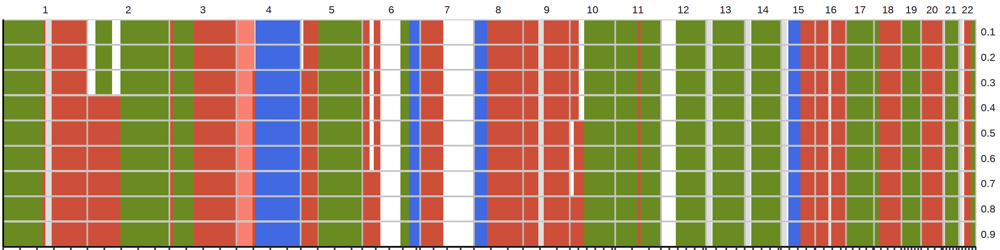

In [1177]:
options(repr.plot.width = 12, repr.plot.height = 3, repr.plot.res = 200)

segs %>% 
filter(min_overlap > 0 & min_overlap < 1) %>%
mutate(method = min_overlap, cnv_state = cnv_state_post) %>% cnv_heatmap() + guides(fill = 'none')

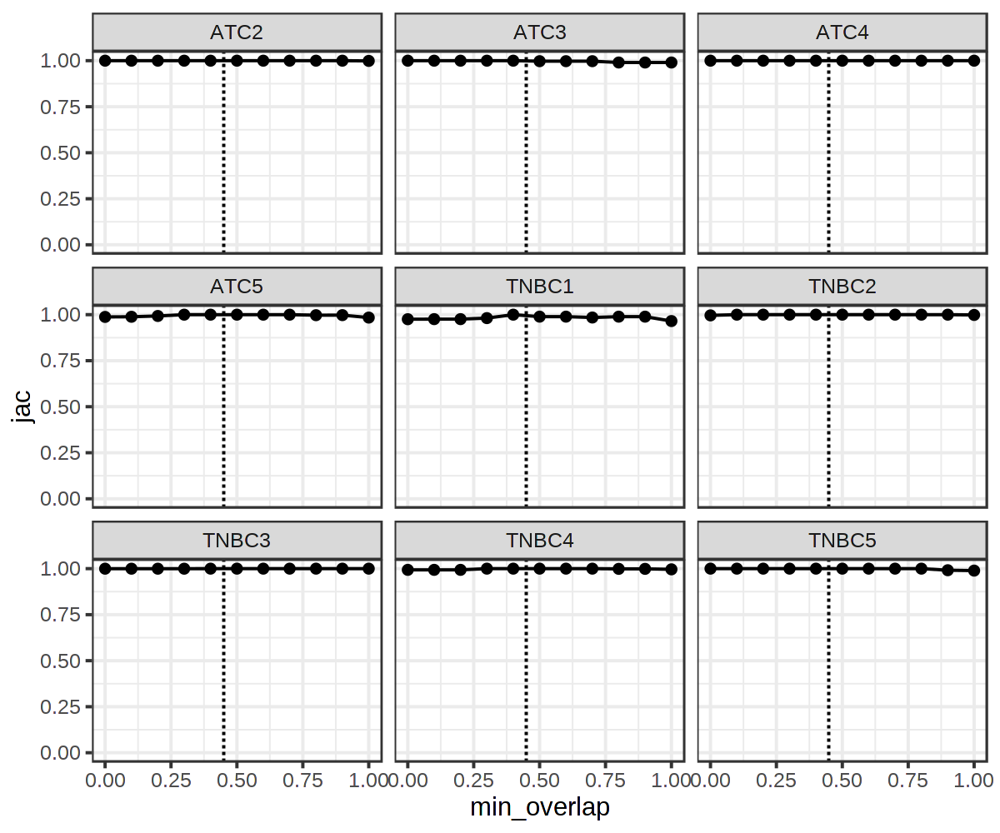

In [1179]:
options(repr.plot.width = 6, repr.plot.height = 5, repr.plot.res = 200)

segs_all %>% 
filter(sample != 'ATC2_subsampled') %>%
ggplot(
    aes(x = min_overlap, y = jac)
) +
facet_wrap(~sample) +
geom_line() +
geom_point() +
geom_vline(xintercept = 0.45, linetype = 'dashed') +
theme_bw() +
ylim(0,1)

## Iterations

In [1652]:
iter_samples = c('TNBC1', 'TNBC5', 'ATC1', 'ATC2')

res = list()

for (sample in iter_samples) {
    message(sample)
    out_dir = glue('~/paper_data/numbat_out/{sample}_iter')
    for (i in 1:8) {
        res[[sample]][[i]] = list()
        res[[sample]][[i]]$gtree = readRDS(glue('{out_dir}/tree_final_{i}.rds'))
        res[[sample]][[i]]$joint_post = fread(glue('{out_dir}/joint_post_{i}.tsv'))
        res[[sample]][[i]]$segs_consensus = fread(glue('{out_dir}/segs_consensus_{i}.tsv'))
    }
}

TNBC1

TNBC5

ATC1

ATC2



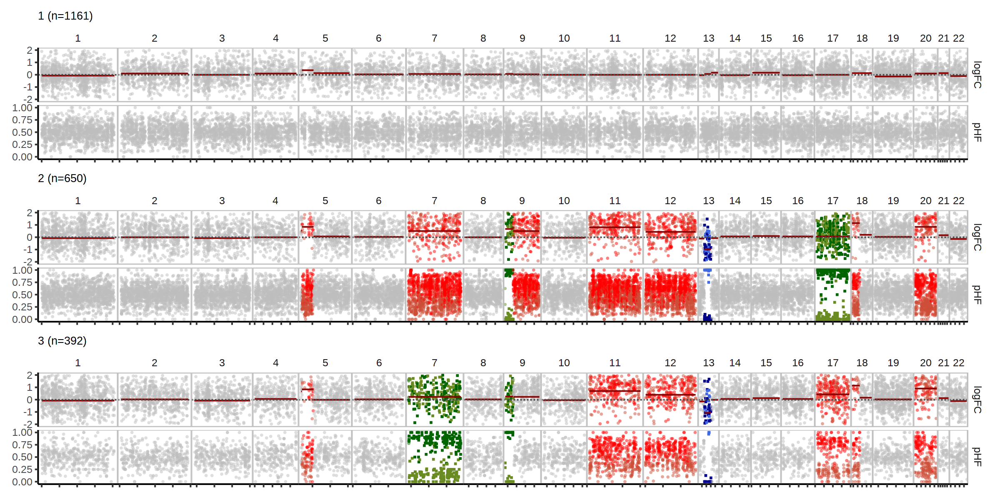

In [1678]:
options(repr.plot.width = 12, repr.plot.height = 6, repr.plot.res = 200)

nb[['ATC1']]$bulk_clones %>% plot_bulks(min_LLR = 40)

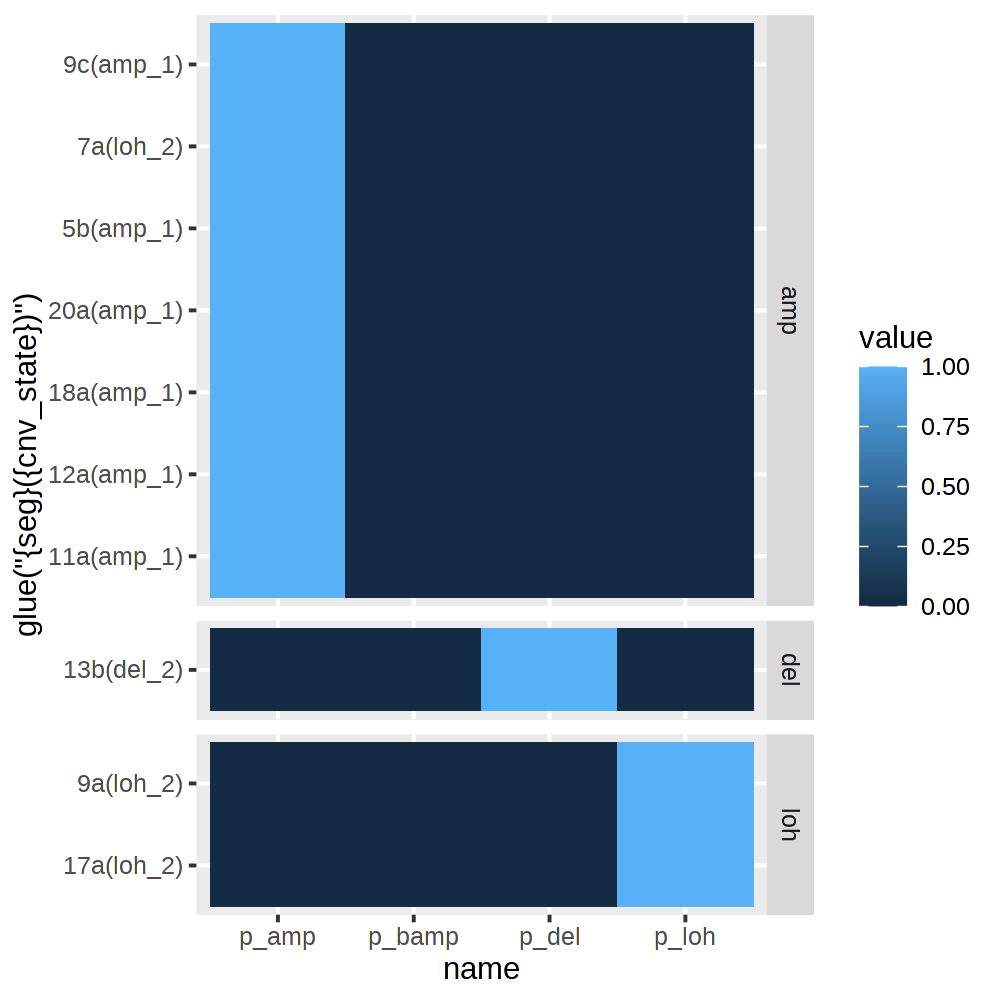

In [1684]:
options(repr.plot.width = 5, repr.plot.height = 5, repr.plot.res = 200)

R.utils::sourceDirectory('~/Numbat/R')

nb[['ATC1']]$bulk_clones %>%
filter(sample == 2) %>%
filter(cnv_state != 'neu') %>%
distinct(seg, cnv_state_post, cnv_state, phi_mle, theta_mle, phi_sigma, theta_sigma) %>%
rowwise() %>%
mutate(p_geno_2d(theta_mle, phi_mle, theta_sigma, phi_sigma)) %>%
tidyr::pivot_longer(cols = c('p_amp', 'p_bamp', 'p_del', 'p_loh')) %>%
ggplot(
    aes(x = name, y = glue('{seg}({cnv_state})'), fill = value)
) +
geom_tile() +
facet_grid(cnv_state_post~., scale = 'free_y', space = 'free_y')

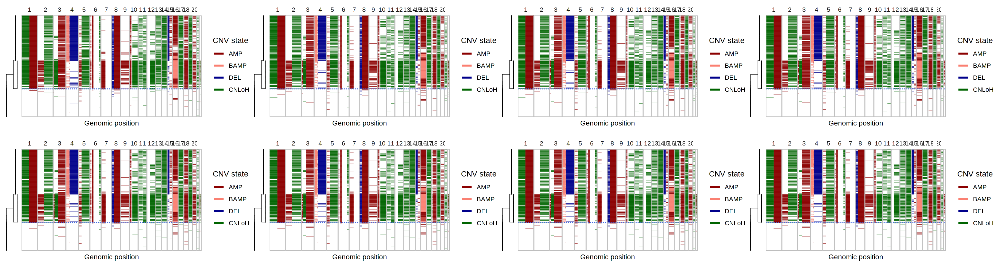

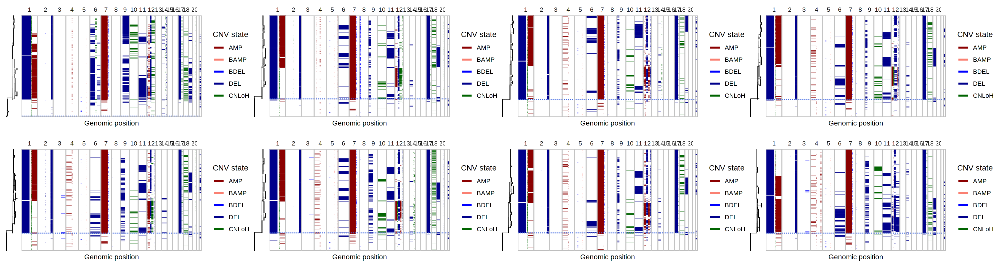

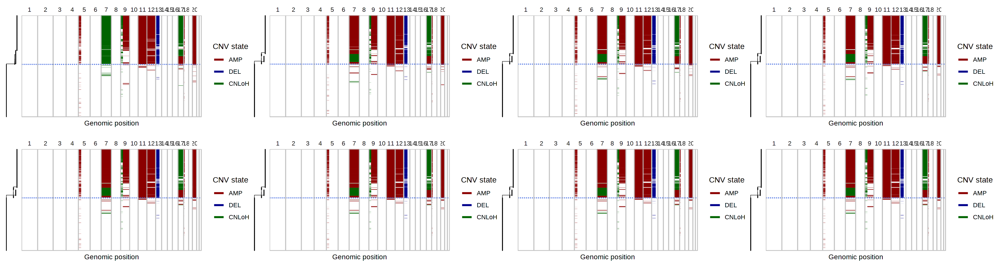

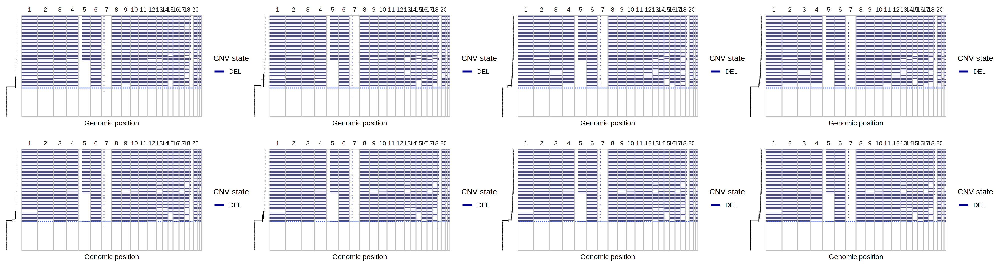

In [1653]:
options(repr.plot.width = 20, repr.plot.height = 5.5, repr.plot.res = 200)

for (sample in iter_samples) {
    
    lapply(
        1:8,
        function(i) {
            plot_phylo_heatmap(
                res[[sample]][[i]]$gtree,
                res[[sample]][[i]]$joint_post,
                res[[sample]][[i]]$segs_consensus
            )
        }
    ) %>%
    wrap_plots(nrow = 2) %>%
    print
    
}

In [1654]:
max_iter = 8

iter_scores = sapply(
    iter_samples,
    function(sample) {
        sapply(
            1:max_iter,
            function(i) {
                compare_segs(
                    res[[sample]][[i]]$segs_consensus %>% filter(cnv_state != 'neu'),
                    res[[sample]][[max_iter]]$segs_consensus %>% filter(cnv_state != 'neu')
                ) %>% suppressWarnings()
            }
        )
    }
) %>%
as.data.frame() %>%
mutate(i = 1:max_iter) %>%
tidyr::pivot_longer(
    cols = iter_samples,
    names_to = 'sample',
    values_to = 'similarity'
)

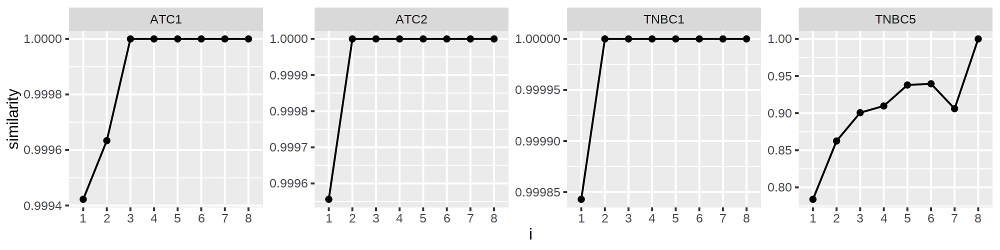

In [1655]:
options(repr.plot.width = 10, repr.plot.height = 2.5, repr.plot.res = 200)

iter_scores %>%
mutate(i = as.factor(i)) %>%
ggplot(
    aes(x = i, y = similarity, group = '')
) +
geom_line() +
geom_point() +
facet_wrap(~sample, scale = 'free', nrow = 1)

## Initialization

In [1621]:
random_samples = c('TNBC1', 'TNBC5', 'ATC1', 'ATC2')

res_random = list()

for (sample in random_samples) {
    for (seed in 1:3) {
        res_random[[sample]][[seed]] = list()
        out_dir = glue('~/paper_data/numbat_out/{sample}_random_{seed}')
        i = 2
        res_random[[sample]][[seed]]$gtree = readRDS(glue('{out_dir}/tree_final_{i}.rds'))
        res_random[[sample]][[seed]]$joint_post = fread(glue('{out_dir}/joint_post_{i}.tsv'))
        res_random[[sample]][[seed]]$segs_consensus = fread(glue('{out_dir}/segs_consensus_{i}.tsv'))
    }
}

In [1382]:
plots = lapply(
    sort(str_subset(random_samples, 'ATC1|TNBC1|TNBC5')),
    function(sample) {
        nb[[sample]]$plot_phylo_heatmap()
    }
)

Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


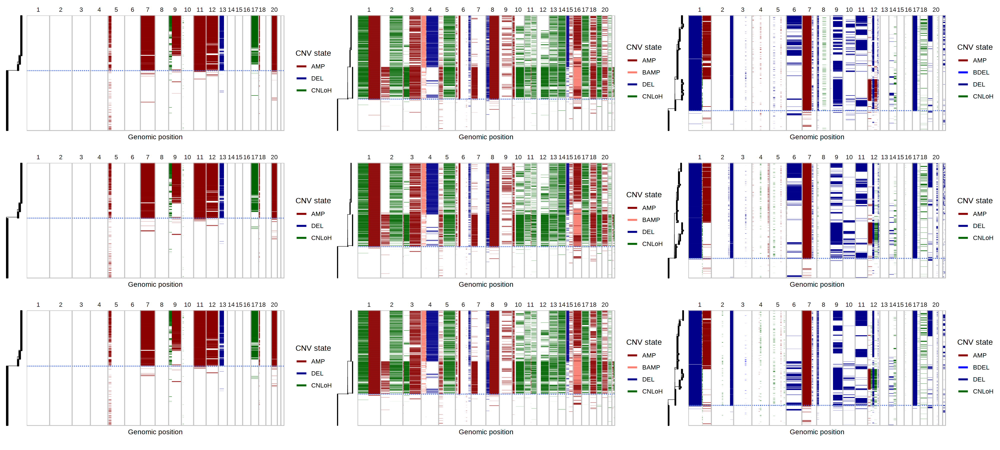

In [1383]:
options(repr.plot.width = 20, repr.plot.height = 9, repr.plot.res = 200)

wrap_plots(plots, byrow = F)

In [1641]:
random_scores = sapply(
        random_samples,
        function(sample) {
            sapply(
                1:3,
                function(seed) {
                     compare_segs(
                        res_random[[sample]][[seed]]$segs_consensus %>% filter(cnv_state != 'neu'),
                        nb[[sample]]$segs_consensus %>% filter(cnv_state != 'neu')
                    ) %>% suppressWarnings()
                }
            )
        }
    ) %>%
    as.data.frame() %>%
    mutate(seed = 1:3) %>%
    tidyr::pivot_longer(
        cols = random_samples,
        names_to = 'sample',
        values_to = 'similarity'
    )

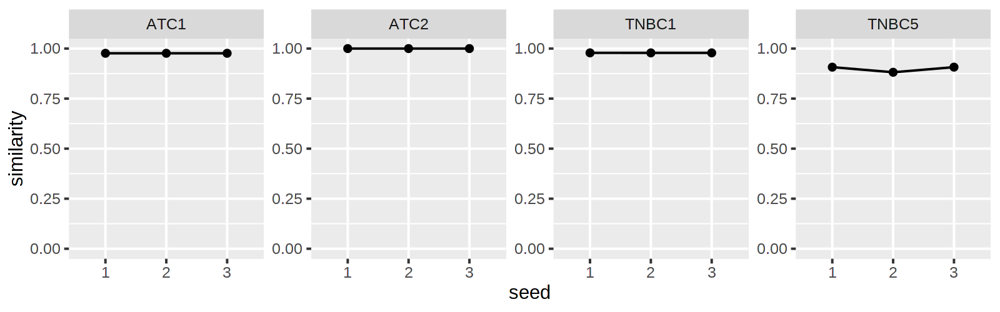

In [1649]:
options(repr.plot.width = 8, repr.plot.height = 2.5, repr.plot.res = 200)

random_scores %>%
mutate(seed = factor(seed)) %>%
ggplot(
    aes(x = seed, y = similarity, group = '')
) +
geom_line() +
geom_point() +
facet_wrap(~sample, scale = 'free', nrow = 1) +
ylim(0,1)

In [ ]:
sample = 'ATC2'

cells_tumor = cell_annot[[sample]] %>% filter(annot == 'T') %>% pull(cell)

cells_normal = cell_annot[[sample]] %>%
    filter(annot == 'N') %>% 
    pull(cell) %>% sample(length(cells_tumor))

cells = c(cells_normal, cells_tumor)

clust = exp_hclust(
    count_mat = count_mat[[sample]][,cells],
    lambdas_ref = numbat::ref_hca[,ref_types],
    gtf_transcript = numbat::gtf_hg38,
    ncores = 10
)

In [1398]:
hc = readRDS('~/paper_data/numbat_out/ATC2/hc.rds')

sample = 'ATC2'

d = cell_annot[[sample]] %>%
    mutate(cluster = cutree(hc, k = 3)[cell]) %>%
    mutate(node = setNames(1:length(hc$labels), hc$labels)[cell], color = ifelse(cluster.pred == 'T', 'red', 'black')) %>%
    select(node, color)

In [1420]:
p_tree = ggtree(hc, layout = 'dendrogram')

In [1449]:
options(repr.plot.width = 6, repr.plot.height = 3, repr.plot.res = 200)

p_tree = ggtree(hc, layout = 'dendrogram', size = 0.1) %<+% d + aes(color=I(color)) +
    geom_tippoint(aes(color = as.factor(color)), size=1, stroke = 0.2)

p_tree$data = p_tree$data %>% mutate(color = ifelse(is.na(color), 'black', color))

In [1452]:
cell_annot[[sample]] %>%
    mutate(cluster = cutree(hc, k = 2)[cell]) %>%
    count(cluster, cluster.pred)

cluster,cluster.pred,n
<int>,<chr>,<int>
1,N,6077
1,T,20
2,T,129


In [1453]:
129/(20 + 129)

[1] 0.8657718

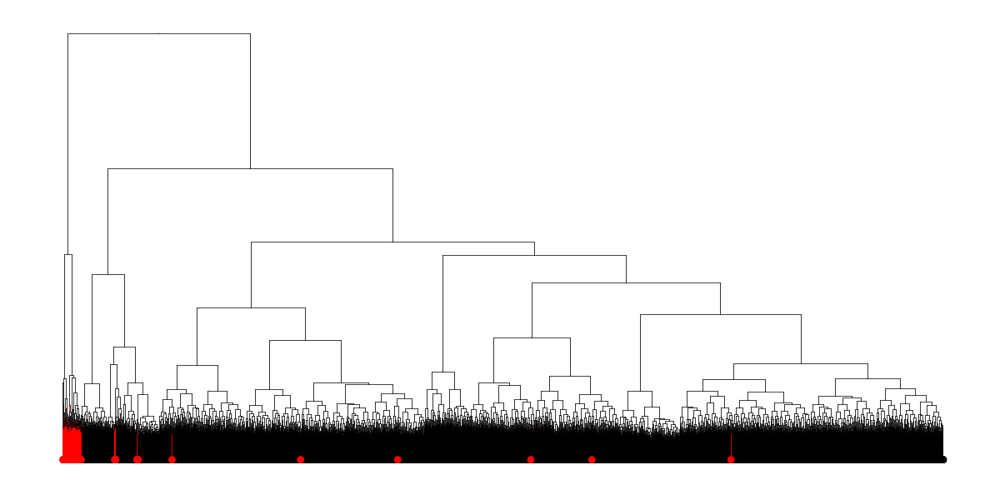

In [1450]:
p_tree

In [ ]:
options(repr.plot.width = 8, repr.plot.height = 4, repr.plot.res = 200)

sample = 'TNBC1'

plot_phylo_heatmap(
    nb[[sample]]$gtree, 
    nb[[sample]]$joint_post %>%
        left_join(
            nb[[sample]]$segs_consensus %>% select(seg = seg_cons, seg_start, seg_end),
            by = 'seg'
        ) %>%
        filter(seg %in% segs),
    nb[[sample]]$segs_consensus,
    pal_annot = c('1' = 'red3'),
    annot_title = var,
    geno_bar = F
) +
ggtitle(sample)